In [1]:
%load_ext autoreload
%autoreload 2

from copy import deepcopy
from kneed import KneeLocator
import matplotlib
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle
import scipy.ndimage as spnd
from scipy.stats import sem
import slicetca
from tifffile import imread
import torch

from caImageAnalysis.bruker_2P.bruker_tank import BrukerTank
from caImageAnalysis.sliceTCA import *
from caImageAnalysis.temporal import *

In [2]:
# region = "vagal"
region = "hindbrain"

##### Load the data

In [7]:
dfs = list()

if region == "vagal":
	fps = 1.3039181195774172

	data_folder = r'/Volumes/Rapid/bruker2P_data/vagal'

	successful_fish = [9, 11, 13, 14, 16, 17, 18, 21, 23, 29, 30, 31, 32, 33, 34, 35, 36, 
	37, 38, 39, 40, 42, 47, 59, 61, 62, 64, 65, 66]
	region = 'vagal'

	tank = BrukerTank(data_folder, successful_fish, prefix='elavl3H2BGCaMP', 
	load_fish=False, region=region)
	dfs.append(tank.monotonic_df)

elif region == "hindbrain":
	fps = 1.3039181436297982

	data_folder = r'/Volumes/Rapid/bruker2P_data/hindbrain'

	successful_fish = [8, 49, 51, 52, 55, 67, 68, 70, 71, 73, 74, 75, 76]
	region = 'hindbrain'

	tank = BrukerTank(data_folder, successful_fish, prefix='elavl3H2BGCaMP', 
	load_fish=False, region=region)
	dfs.append(tank.monotonic_df)

df = pd.concat(dfs, ignore_index=True)

##### Make the data tensor

In [8]:
smooth = True

n_pulses = 4  # number of pulses that will go into TCA
pre_frame_num = 3
post_frame_num = 13
key = "raw_norm_temporal"
normalize = False
normalize_by_first = True

df = df[df["responsive"] == True]
df = df.sort_values(by=["stimulus", "region", "fish_id"]).reset_index()
df = df.drop(columns=["index"])

x, traces, stimuli = get_traces(df, pre_frame_num=pre_frame_num, post_frame_num=post_frame_num, normalize=normalize,
               normalize_by_first=normalize_by_first, key=key, only_responsive=False, return_col="stimulus")
_, _, regions = get_traces(df, pre_frame_num=pre_frame_num, post_frame_num=post_frame_num, normalize=normalize,
               normalize_by_first=normalize_by_first, key=key, only_responsive=False, return_col="region")
pulses = np.concatenate([np.arange(1, len(row["pulse_frames"])+1) for _, row in df.iterrows()])

raw_neural_data = np.array([np.array(traces)[np.where(pulses == i+1)] for i in range(n_pulses)])

# smooth along time axis, using a Gaussian filter
if smooth:
	neural_data = spnd.gaussian_filter1d(raw_neural_data, sigma=1, axis=-1)
else:
	neural_data = raw_neural_data
print(neural_data.shape)  # needs to be neurons, time, pulse

stimuli = np.array([np.array(stimuli)[np.where(pulses == i+1)] for i in range(n_pulses)])
regions = np.array([np.array(regions)[np.where(pulses == i+1)] for i in range(n_pulses)])

print(neural_data.std())
neural_data = neural_data/neural_data.std()

device = torch.device("cpu")
data = torch.from_numpy(neural_data).float().to(device)

(4, 6128, 17)
1.5166059495633741


##### See how your neurons look like

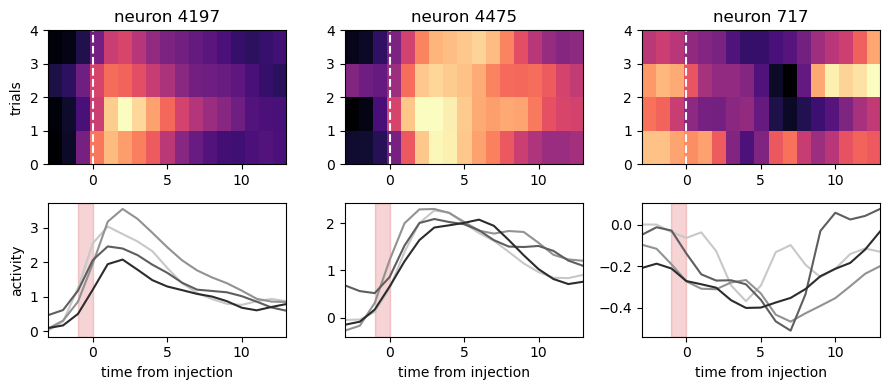

In [22]:
# import random
# neurons = random.sample(range(len(df)), 3)

if region == "vagal":
	neurons = [df[(df.fish_id == 29) & (df.plane == 2) & (df.neuron == 15)].index.values[0], 
			df[(df.fish_id == 30) & (df.plane == 0) & (df.neuron == 8)].index.values[0], 
			df[(df.fish_id == 39) & (df.plane == 0) & (df.neuron == 1)].index.values[0]]

elif region == "hindbrain":
	neurons = [df[(df.fish_id == 67) & (df.plane == 0) & (df.neuron == 130)].index.values[0], 
			df[(df.fish_id == 67) & (df.plane == 3) & (df.neuron == 699)].index.values[0], 
			df[(df.fish_id == 49) & (df.plane == 4) & (df.neuron == 1026)].index.values[0]]

colors = {
	0: "#C8C8C8",
	1: "#929292",
	2: "#5E5E5E",
	3: "#2C2C2C"
}

plt.figure(figsize=(9,4), dpi=100)

for ni, n in enumerate(neurons):
    plt.subplot(2, 3, ni+1)
    plt.imshow(neural_data[:, n, :], aspect='auto', extent=[0-pre_frame_num, post_frame_num, 0, len(neural_data)], cmap='magma', origin='lower')
    plt.plot([0,0], [0,len(neural_data)], 'w--')
    if ni == 0:
           plt.ylabel('trials')
    plt.title('neuron ' + str(n))

# condition-averaged, scaled & smoothed PSTHs
for ni, n in enumerate(neurons):
    plt.subplot(2, 3, ni+4)
    for ai, a in enumerate(np.arange(neural_data.shape[0])):
        plt.plot(np.linspace(0-pre_frame_num, post_frame_num, neural_data.shape[2]), neural_data[ai, n, :], ls='-', color=colors[ai])
    plt.axvspan(-1, 0, alpha=0.2, color="tab:red")
    if ni==0: plt.ylabel('activity')
    plt.xlim([0-pre_frame_num,post_frame_num])
    plt.xlabel('time from injection')
plt.tight_layout()

### Cross-validated model selection

##### Find the dimensions of the test mask

Auto-covariance

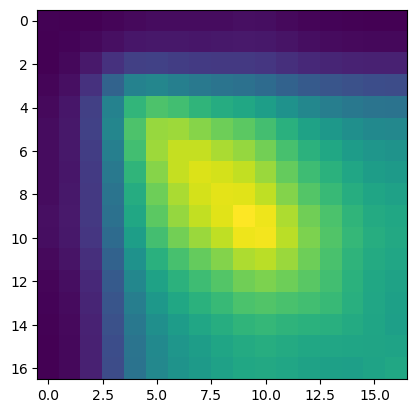

In [28]:
plt.imshow(compute_covariance_matrix(neural_data))

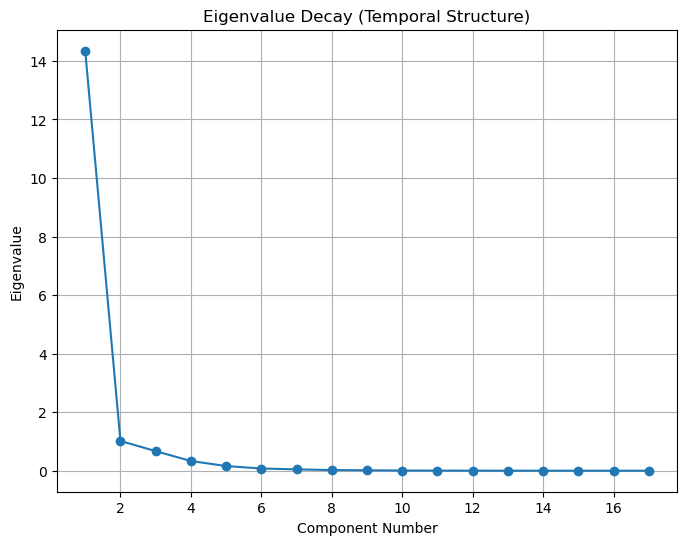

Number of time points needed to explain 90.0% of the variance: 2


In [29]:
threshold = 0.9

# Step 1: Compute the covariance matrix along the time axis
covariance_matrix = compute_covariance_matrix(neural_data)

# Step 2: Perform eigenvalue decomposition
eigenvalues, eigenvectors = perform_eigenvalue_decomposition(covariance_matrix)

# Step 3: Plot the eigenvalue decay
plot_eigenvalue_decay(eigenvalues)

# Step 4: Determine how many time points explain 90% of the variance
num_components = calculate_variance_explained(eigenvalues, threshold=threshold)

print(f"Number of time points needed to explain {threshold*100}% of the variance: {num_components}")

Scatter plot

1: p-value: 0.0, corr: 0.9686823301361929
2: p-value: 0.0, corr: 0.900172083610981
3: p-value: 0.0, corr: 0.8344484982149789
4: p-value: 0.0, corr: 0.7875980324900937
5: p-value: 0.0, corr: 0.7557119527289096
6: p-value: 0.0, corr: 0.7303312132531462
7: p-value: 0.0, corr: 0.7073079765092827
8: p-value: 0.0, corr: 0.6856835901287034
9: p-value: 0.0, corr: 0.6652675734729789
10: p-value: 0.0, corr: 0.6448463299198945
11: p-value: 0.0, corr: 0.6243857576406493
12: p-value: 0.0, corr: 0.6046780207018183
13: p-value: 0.0, corr: 0.5838683642841039
14: p-value: 0.0, corr: 0.5535842974013702
15: p-value: 0.0, corr: 0.5130536552979806
16: p-value: 0.0, corr: 0.47823447424431687


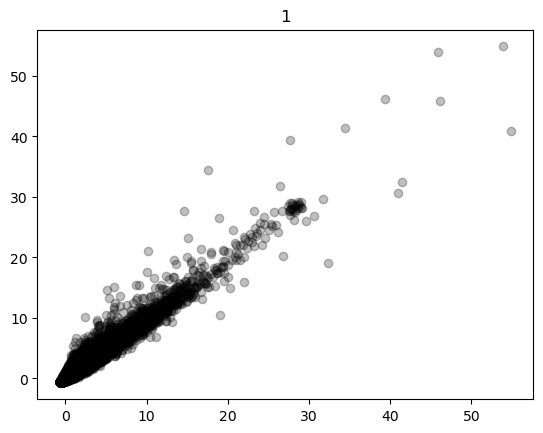

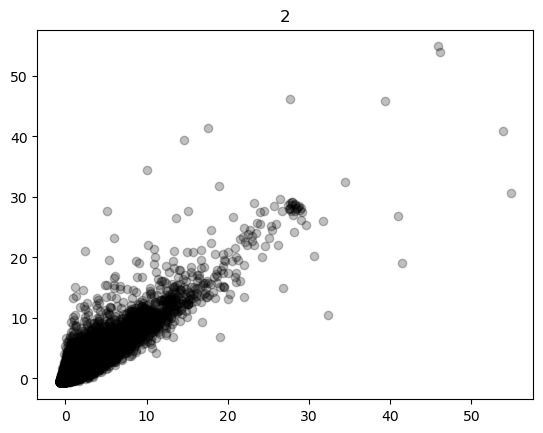

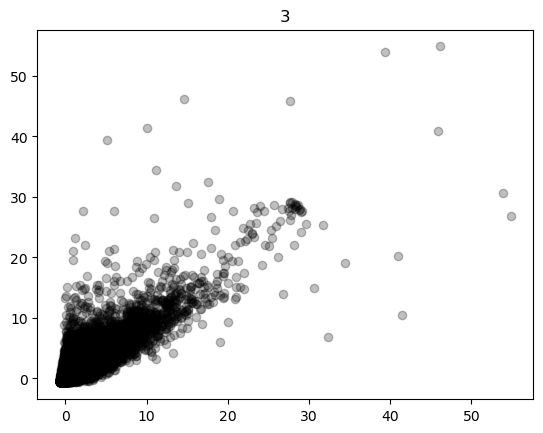

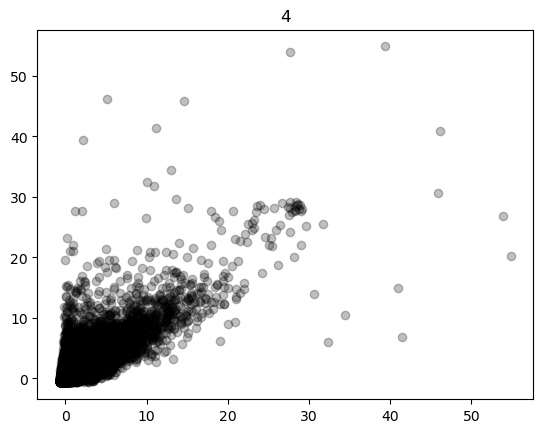

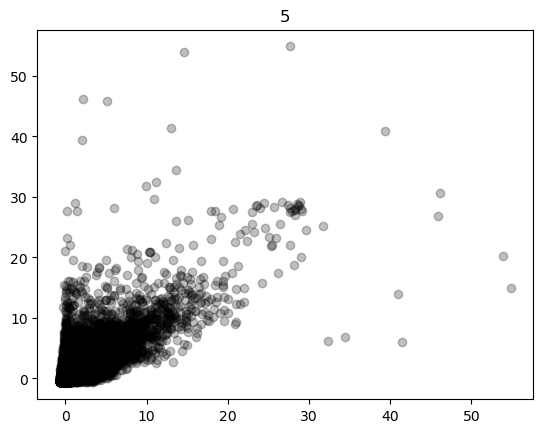

...

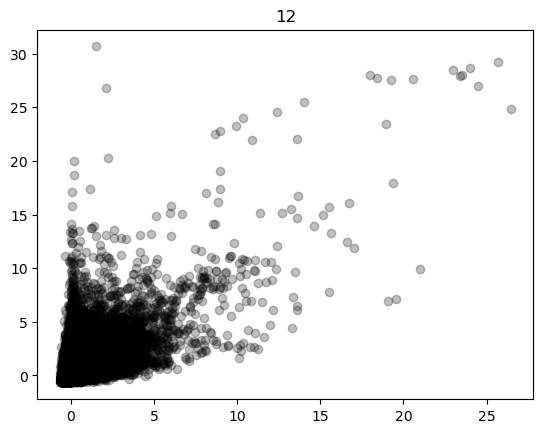

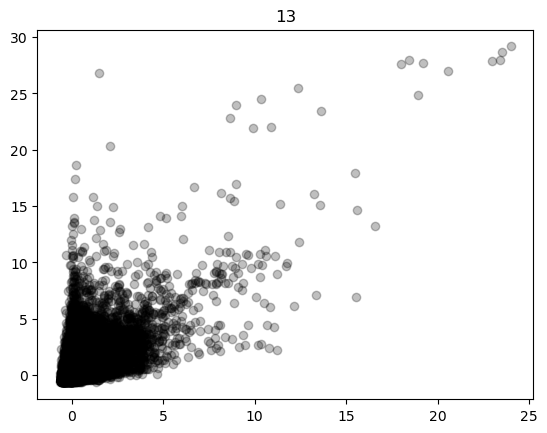

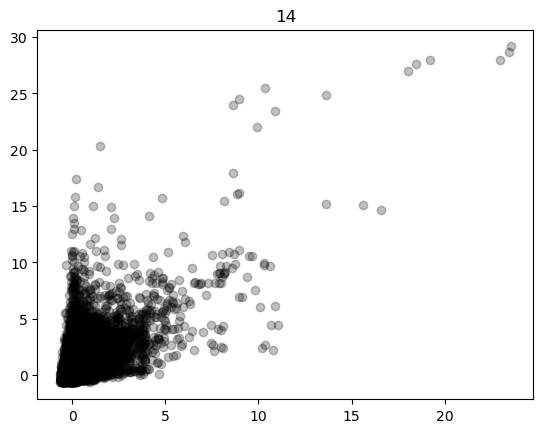

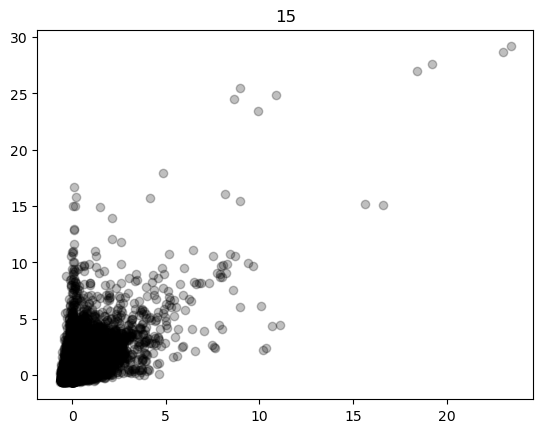

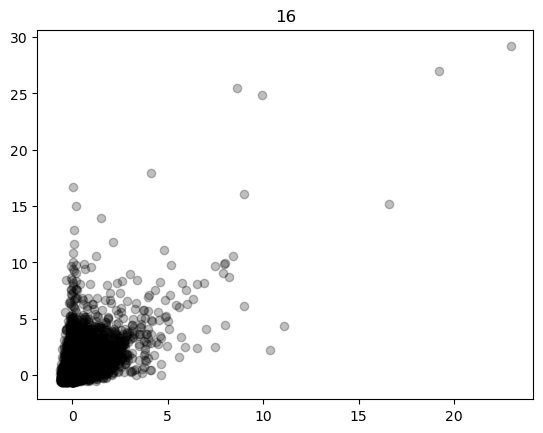

In [30]:
from scipy.stats import spearmanr

frame_differences = np.arange(1, 17)

for fd in frame_differences:
	xs = list()
	ys = list()

	for i in range(neural_data.shape[2]):
		try:
			x = neural_data[:, :, i].flatten()
			y = neural_data[:, :, i+fd].flatten()
			xs.extend(x)
			ys.extend(y) 
		except IndexError:
			pass
	
	plt.figure()
	plt.scatter(xs, ys, color='k', alpha=0.25)
	plt.title(fd)
	
	res = spearmanr(xs, ys)

	print(f"{fd}: p-value: {res.pvalue}, corr: {res.statistic}")

##### Make train and test masks

In [515]:
test_dim = 2
# train_dim = int((neural_data.shape[2] - (2 * test_dim + 1) - 1) / 2)

In [9]:
train_mask, test_mask = slicetca.block_mask(dimensions=data.shape,
                                            train_blocks_dimensions=(0, 0, 3), # Note that the blocks will be of size 2*train_blocks_dimensions + 1
                                            test_blocks_dimensions=(0, 0, 1), # Same, 2*test_blocks_dimensions + 1
                                            fraction_test=0.2, # The maximum fraction of entries in the test_mask
                                            device=device)

In [10]:
train_mask[0][6]

tensor([ True,  True,  True,  True,  True,  True,  True,  True, False, False,
        False, False, False, False, False,  True,  True])

In [11]:
test_mask[0][6]

tensor([False, False, False, False, False, False, False, False, False, False,
         True,  True,  True, False, False, False, False])

In [12]:
# Try to minimize the n_unused_data
n_used_data = len(train_mask.flatten()[np.where(train_mask.flatten() == True)]) + len(test_mask.flatten()[np.where(test_mask.flatten() == True)])
n_unused_data = len(data.flatten()) - n_used_data
print(n_used_data, n_unused_data)

345847 70857


In [1439]:
# Use the entire dataset for train and test
train_mask = torch.full(data.shape, True, device=device)
test_mask = torch.full(data.shape, True, device=device)

##### Run grid search

Grid shape: [5, 11, 11] - Samples: 10 - Grid entries: 605 - Number of models to fit: 6050


Number of components (completed): (4, 10, 10) : 100%|██████████| 605/605 [13:38:39<00:00, 81.19s/it]   


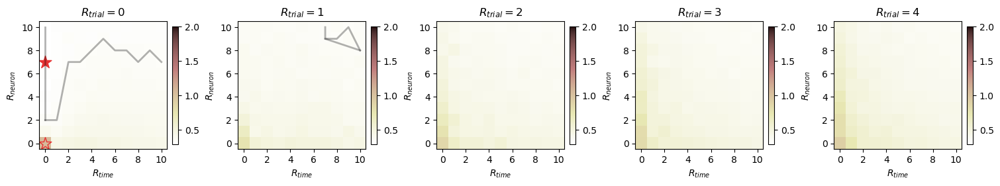

In [13]:
loss_grid, seed_grid = slicetca.grid_search(data,
											min_ranks = [0, 0, 0],
											max_ranks = [data.shape[0], 10, 10],
											sample_size=10, # Number of seeds to use for a given number of components.
											mask_train=train_mask,
											mask_test=test_mask,
											processes_grid=10,
											seed=1, # Numpy seed.
											initialization="uniform",
											learning_rate=0.001,
											max_iter=10000,
											min_std=10**-4,
											)
	
# Plot the loss grid
elbow = 0.95
slicetca.plot_grid(loss_grid, reduction="mean", min_ranks=(0, 0, 0), elbow=elbow, data=neural_data, vmax=2)

#### Load the grid

In [18]:
filename = "loss_seed_grids_train3_test1.p"

file = open(tank.folder_path.joinpath(filename),'rb')
loss_grid, seed_grid, train_mask, test_mask = pickle.load(file)
file.close()

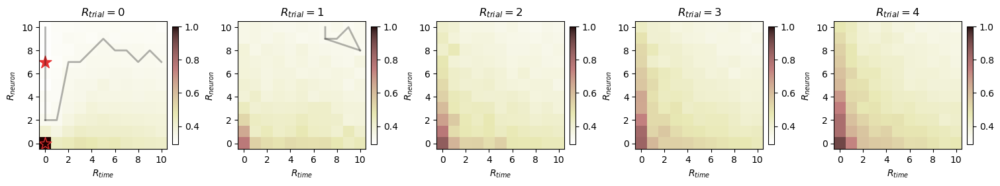

In [19]:
# Plot the loss grid
elbow = 0.95 
slicetca.plot_grid(loss_grid, reduction="mean", min_ranks=(0, 0, 0), elbow=elbow, data=neural_data, vmax=1)

Text(0, 0.5, 'cv loss')

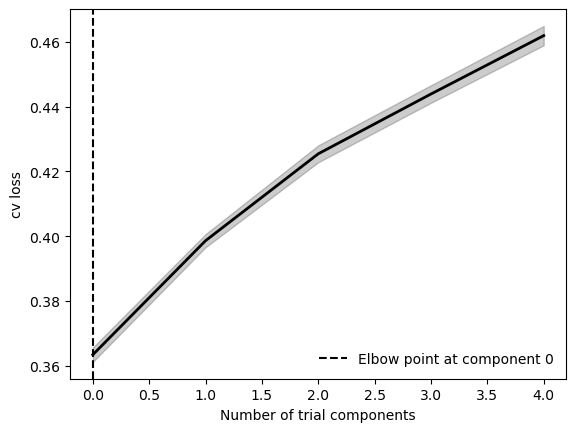

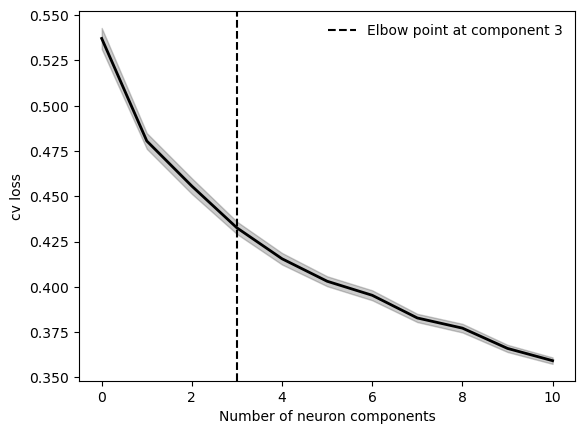

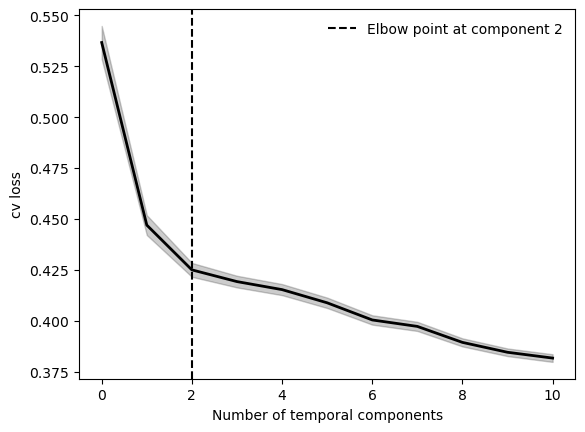

In [20]:
# Plot the losses for trial, neuron, and time separately
plot_individual = False

reduced_loss_grid = loss_grid.mean(axis=-1)
elbow_threshold = np.min(reduced_loss_grid)*elbow+np.mean(neural_data**2)*(1-elbow)

# TRIAL-SLICING COMPONENTS
plt.figure()

n_neuron_comps = loss_grid.shape[1]
n_time_comps = loss_grid.shape[2]
n_seeds = loss_grid.shape[3]

traces = list()

for n in range(n_neuron_comps):
	for t in range(n_time_comps):
		# plt.plot(np.mean(loss_grid[:, n, t, :], axis=1), color="gray", alpha=0.5)
		for s in range(n_seeds):
			if plot_individual:
				plt.plot(loss_grid[:, n, t, s], color="gray", alpha=0.5)
			traces.append(loss_grid[:, n, t, s])

plt.plot(np.mean(traces, axis=0), linewidth=2, color="black")
plt.fill_between(np.arange(len(traces[0])), np.mean(traces, axis=0)-sem(traces, axis=0), np.mean(traces, axis=0)+sem(traces, axis=0), color="black", alpha=0.2)

kn = KneeLocator(np.arange(loss_grid.shape[0]), np.mean(traces, axis=0), curve="convex", direction="decreasing")
plt.axvline(kn.knee, linestyle="dashed", color="black", label=f"Elbow point at component {int(kn.knee)}")

# plt.axhline(elbow_threshold, linestyle="dashed", color="tab:red", label=f"95% elbow point")
plt.legend(frameon=False)
plt.xlabel("Number of trial components")
plt.ylabel("cv loss")

# NEURON-SLICING COMPONENTS
plt.figure()

n_trial_comps = loss_grid.shape[0]
n_time_comps = loss_grid.shape[2]
n_seeds = loss_grid.shape[3]

traces = list()

for n in range(n_trial_comps):
	for t in range(n_time_comps):
		# plt.plot(np.mean(loss_grid[n, :, t, :], axis=1), color="gray", alpha=0.5)
		for s in range(n_seeds):
			if plot_individual:
				plt.plot(loss_grid[n, :, t, s], color="gray", alpha=0.5)
			traces.append(loss_grid[n, :, t, s])

plt.plot(np.mean(traces, axis=0), linewidth=2, color="black")
plt.fill_between(np.arange(len(traces[0])), np.mean(traces, axis=0)-sem(traces, axis=0), np.mean(traces, axis=0)+sem(traces, axis=0), color="black", alpha=0.2)

kn = KneeLocator(np.arange(loss_grid.shape[1]), np.mean(traces, axis=0), curve="convex", direction="decreasing")
plt.axvline(kn.knee, linestyle="dashed", color="black", label=f"Elbow point at component {int(kn.knee)}")
# plt.axhline(elbow_threshold, linestyle="dashed", color="tab:red", label=f"95% elbow point")
plt.legend(frameon=False)
plt.xlabel("Number of neuron components")
plt.ylabel("cv loss")

# TIME-SLICING COMPONENTS
plt.figure()

n_trial_comps = loss_grid.shape[0]
n_neuron_comps = loss_grid.shape[1]
n_seeds = loss_grid.shape[3]

traces = list()

for n in range(n_trial_comps):
	for t in range(n_neuron_comps):
		# plt.plot(np.mean(loss_grid[n, t, :, :], axis=1), color="gray", alpha=0.5)
		for s in range(n_seeds):
			if plot_individual:
				plt.plot(loss_grid[n, t, :, s], color="gray", alpha=0.5)
			traces.append(loss_grid[n, t, :, s])

plt.plot(np.mean(traces, axis=0), linewidth=2, color="black")
plt.fill_between(np.arange(len(traces[0])), np.mean(traces, axis=0)-sem(traces, axis=0), np.mean(traces, axis=0)+sem(traces, axis=0), color="black", alpha=0.2)

kn = KneeLocator(np.arange(loss_grid.shape[2]), np.mean(traces, axis=0), curve="convex", direction="decreasing")
plt.axvline(kn.knee, linestyle="dashed", color="black", label=f"Elbow point at component {int(kn.knee)}")
# plt.axhline(elbow_threshold, linestyle="dashed", color="tab:red", label=f"95% elbow point")
plt.legend(frameon=False)
plt.xlabel("Number of temporal components")
plt.ylabel("cv loss")

In [17]:
pickle.dump([loss_grid, seed_grid, train_mask, test_mask], open(tank.folder_path.joinpath("loss_seed_grids_train3_test1.p"), "wb"))

### Model fitting

In [30]:
stimulus_region_sorting = sort_by_stimulus_region(stimuli, regions)

ordered_regions = regions[0][stimulus_region_sorting]
ordered_stims = stimuli[0][stimulus_region_sorting]

last_region_idxs = np.where(ordered_regions[:-1] != ordered_regions[1:])[0]
if len(last_region_idxs) == 0:  # if there is only a single region, take the final idx of the final element
	last_region_idxs = np.array([ordered_regions.shape[0]])

last_stimulus_idxs = np.where(ordered_stims[:-1] != ordered_stims[1:])[0]
if len(last_stimulus_idxs) == 0:  # if there is only a single stimulus, take the final idx of the final element
	last_stimulus_idxs = np.array([ordered_stims.shape[0]])

region_colors = list()
for idx, reg in enumerate(ordered_regions):
	if reg == "hindbrain":
		# region_colors.append(matplotlib.cm.get_cmap('Set1')(np.mod((3 + 3*np.pi)/(np.pi * 2),1))[:3])
		if ordered_stims[idx] == "eggwater":
			region_colors.append(matplotlib.colors.to_rgba("#5E5E5E", alpha=1)[:3])
		elif ordered_stims[idx] == "glucose":
			region_colors.append(matplotlib.colors.to_rgba("#F66EB1", alpha=1)[:3])
		elif ordered_stims[idx] == "glycine":
			region_colors.append(matplotlib.colors.to_rgba("#208B35", alpha=1)[:3])
		elif ordered_stims[idx] == "AITC":
			region_colors.append(matplotlib.colors.to_rgba("#083F90", alpha=1)[:3])
	elif reg == "vagal_L":
		if ordered_stims[idx] == "eggwater":
			region_colors.append(matplotlib.colors.to_rgba("#A6A6A6", alpha=1)[:3])
		elif ordered_stims[idx] == "glucose":
			region_colors.append(matplotlib.colors.to_rgba("#F66EB1", alpha=1)[:3])
		elif ordered_stims[idx] == "glycine":
			region_colors.append(matplotlib.colors.to_rgba("#66BE22", alpha=1)[:3])
		elif ordered_stims[idx] == "AITC":
			region_colors.append(matplotlib.colors.to_rgba("#4485BF", alpha=1)[:3])
	elif reg == "vagal_R":
		if ordered_stims[idx] == "eggwater":
			region_colors.append(matplotlib.colors.to_rgba("#5E5E5E", alpha=1)[:3])
		elif ordered_stims[idx] == "glucose":
			region_colors.append(matplotlib.colors.to_rgba("#D40079", alpha=1)[:3])
		elif ordered_stims[idx] == "glycine":
			region_colors.append(matplotlib.colors.to_rgba("#208B35", alpha=1)[:3])
		elif ordered_stims[idx] == "AITC":
			region_colors.append(matplotlib.colors.to_rgba("#083F90", alpha=1)[:3])
region_colors = np.array(region_colors)

The model converged. Loss: 0.0708373636007309 :  44%|████▎     | 4352/10000 [00:11<00:15, 371.18it/s]
/var/folders/48/8y2gqcvx5q5575kwkzngl6qw0000gn/T/ipykernel_53971/1539938725.py:27: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  trial_colors = np.array([matplotlib.cm.get_cmap('Reds')(np.mod((i + 3*np.pi)/(np.pi * 2),1))[:3] for i in np.arange(4)])
Loss: 0.14348474144935608 :  17%|█▋        | 1665/10000 [00:04<00:23, 352.34it/s]


KeyboardInterrupt: 

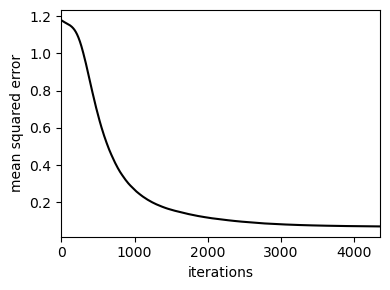

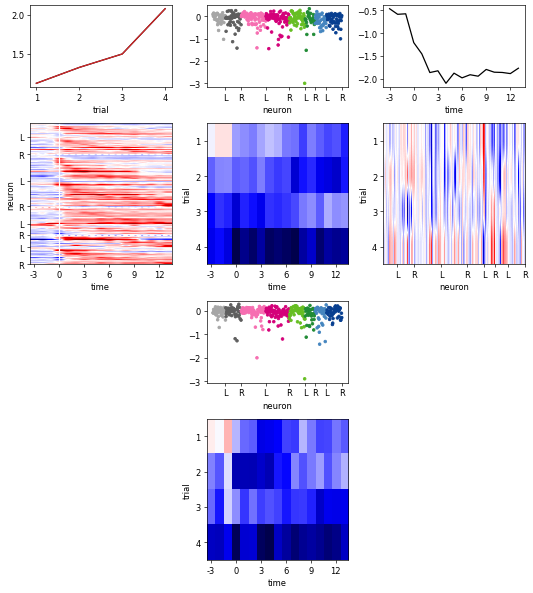

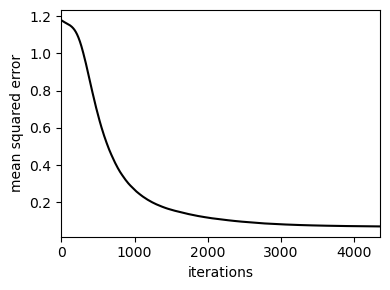

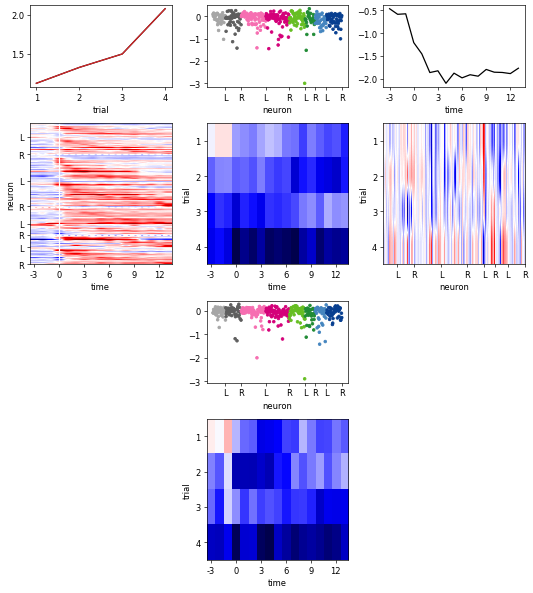

In [ ]:
# Determine decompose parameters
trial = 1
neuron = 2
time = 1

num_components = (trial, neuron, time)

learning_rates = [10**-1, 10**-2, 10**-3, 10**-4, 10**-5, 10**-6]

for lr in learning_rates:

	components, model = slicetca.decompose(data,
										number_components=num_components,
										initialization="uniform",
										learning_rate=0.001,
										min_std=10**-4,
										max_iter=10000,
										seed=1)

	plt.figure(figsize=(4,3), dpi=100)
	plt.plot(model.losses, 'k')
	plt.xlabel('iterations')
	plt.ylabel('mean squared error')
	plt.xlim(0,len(model.losses))
	plt.tight_layout()

	trial_colors = np.array([matplotlib.cm.get_cmap('Reds')(np.mod((i + 3*np.pi)/(np.pi * 2),1))[:3] for i in np.arange(4)])

	# # we sort the neurons of the trial slices according to their peak activity in the first slice.
	if trial != 0:
		ordered_components = components[0][1][0][stimulus_region_sorting]
		final_sorting_idx = list()  # include the end frame

		for i, idx in enumerate(last_region_idxs):
			if i == 0:
				comp_idx = np.argsort(np.argmax(ordered_components[:idx+1], axis=1))
				final_sorting_idx.extend(stimulus_region_sorting[:idx+1][comp_idx])
			else:
				comp_idx = np.argsort(np.argmax(ordered_components[last_region_idxs[i-1]+1:idx+1], axis=1))
				final_sorting_idx.extend(stimulus_region_sorting[last_region_idxs[i-1]+1:idx+1][comp_idx])

		comp_idx = np.argsort(np.argmax(ordered_components[last_region_idxs[-1]+1:], axis=1))
		final_sorting_idx.extend(stimulus_region_sorting[last_region_idxs[-1]+1:][comp_idx])

		final_sorting_idx = np.array(final_sorting_idx)

	ticks = np.append(last_region_idxs, len(stimuli[0]))
	tick_labels = np.array([["L", "R"] for _ in range(int(len(ticks)/2))]).flatten()
			
	# call plotting function, indicating index for sorting trials and colors for different angles as well as time
	axes = slicetca.plot(model,
				variables=("trial", "neuron", "time"),
				colors=(None, region_colors, None), # we only want the trials to be colored
				ticks=(np.arange(4), ticks, np.arange(0, 16, 3)), # we only want to modify the time ticks
				tick_labels=(np.arange(1, 5), tick_labels, np.arange(-3, 13, 3)),
				sorting_indices=(np.arange(4), final_sorting_idx, None),
				quantile=0.99)
	for a, ax in enumerate(axes[0][1]):
		ax.axvline(3, color="white")
		for idx in last_indices[:-1]:
			ax.axhline(idx+1, linestyle="dashed", color="white")
		axes[0][0][a].plot(np.arange(4), components[0][0][a], color="tab:red")

The model converged. Loss: 0.022871963679790497 :  50%|█████     | 5024/10000 [01:02<01:01, 80.55it/s]
/var/folders/48/8y2gqcvx5q5575kwkzngl6qw0000gn/T/ipykernel_53971/3196399612.py:26: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  trial_colors = np.array([matplotlib.cm.get_cmap('Reds')(np.mod((i + 3*np.pi)/(np.pi * 2),1))[:3] for i in np.arange(4)])
The model converged. Loss: 0.017842188477516174 :  57%|█████▋    | 5654/10000 [01:17<00:59, 73.12it/s]
The model converged. Loss: 0.017057867720723152 :  54%|█████▎    | 5371/10000 [01:18<01:07, 68.13it/s]
The model converged. Loss: 0.01547124795615673 :  55%|█████▍    | 5462/10000 [01:25<01:11, 63.82it/s]


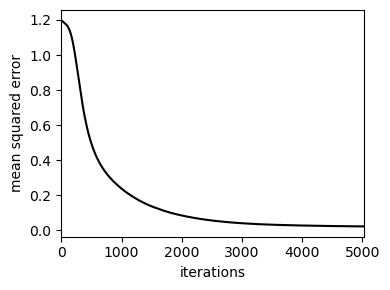

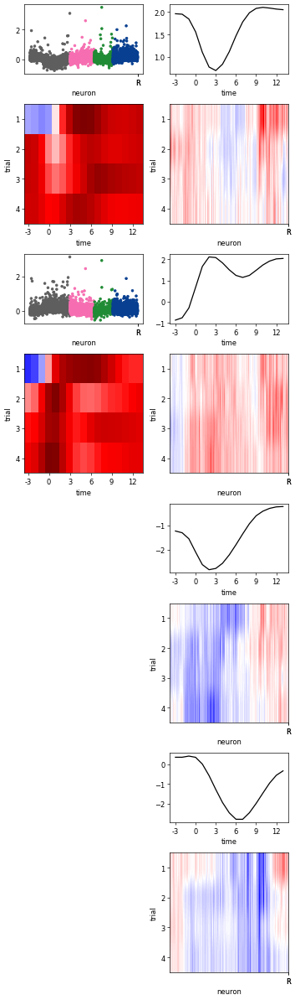

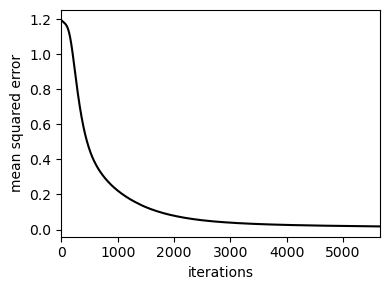

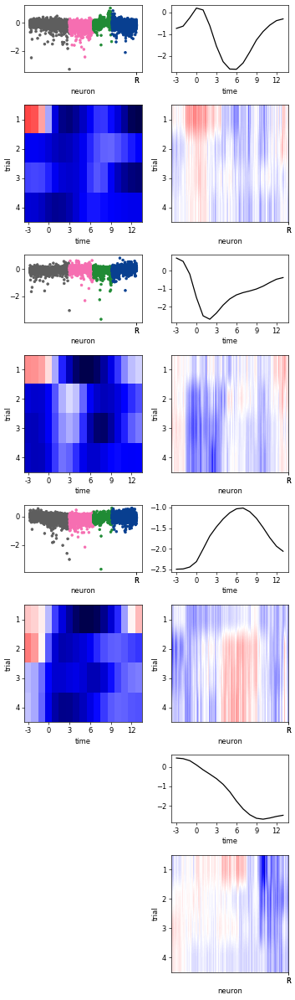

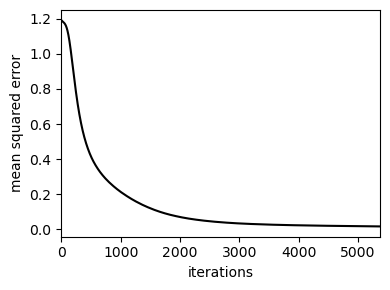

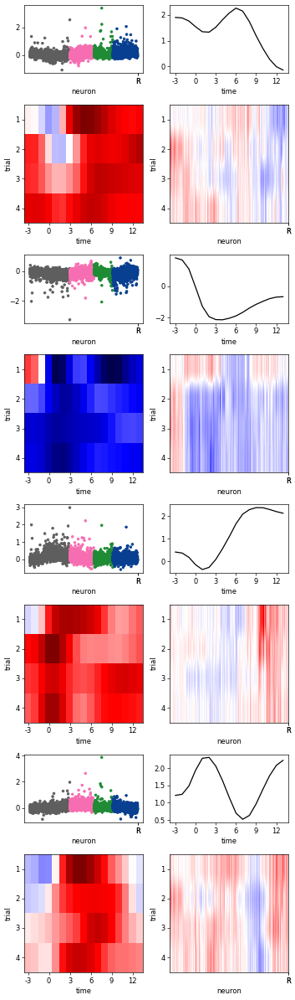

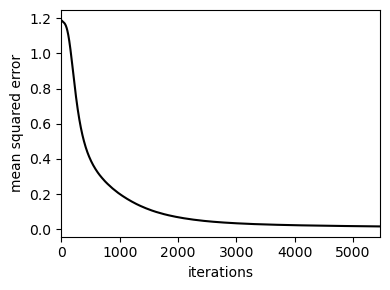

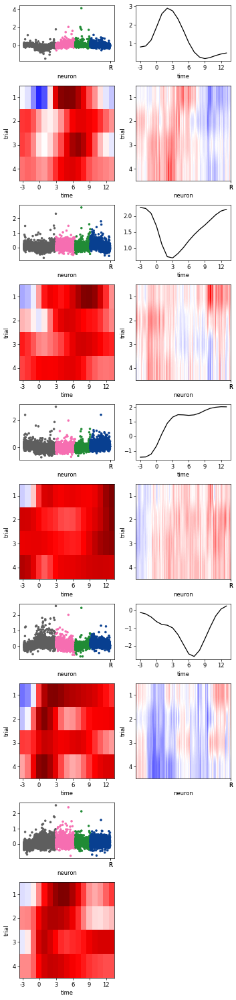

In [149]:
# Run models with the combinations of the given trials, neurons, and times
trials = [0]
neurons = [2, 3, 4, 5]
times = [4]

for trial in trials:
	for neuron in neurons:
		for time in times:
			num_components = (trial, neuron, time)

			components, model = slicetca.decompose(data,
												number_components=num_components,
												initialization="uniform",
												learning_rate=0.001,
												min_std=10**-4,
												max_iter=10000,
												seed=1)

			plt.figure(figsize=(4,3), dpi=100)
			plt.plot(model.losses, 'k')
			plt.xlabel('iterations')
			plt.ylabel('mean squared error')
			plt.xlim(0,len(model.losses))
			plt.tight_layout()

			trial_colors = np.array([matplotlib.cm.get_cmap('Reds')(np.mod((i + 3*np.pi)/(np.pi * 2),1))[:3] for i in np.arange(4)])

			# # we sort the neurons of the trial slices according to their peak activity in the first slice.
			if trial != 0:
				ordered_components = components[0][1][0][stimulus_region_sorting]
				final_sorting_idx = list()  # include the end frame

				for i, idx in enumerate(last_region_idxs):
					if i == 0:
						comp_idx = np.argsort(np.argmax(ordered_components[:idx+1], axis=1))
						final_sorting_idx.extend(stimulus_region_sorting[:idx+1][comp_idx])
					else:
						comp_idx = np.argsort(np.argmax(ordered_components[last_region_idxs[i-1]+1:idx+1], axis=1))
						final_sorting_idx.extend(stimulus_region_sorting[last_region_idxs[i-1]+1:idx+1][comp_idx])

				comp_idx = np.argsort(np.argmax(ordered_components[last_region_idxs[-1]+1:], axis=1))
				final_sorting_idx.extend(stimulus_region_sorting[last_region_idxs[-1]+1:][comp_idx])

				final_sorting_idx = np.array(final_sorting_idx)

			ticks = np.append(last_region_idxs, len(stimuli[0]))
			tick_labels = np.array([["L", "R"] for _ in range(int(len(ticks)/2))]).flatten()
					
			# call plotting function, indicating index for sorting trials and colors for different angles as well as time
			axes = slicetca.plot(model,
						variables=("trial", "neuron", "time"),
						colors=(trial_colors, region_colors, None), # we only want the trials to be colored
						ticks=(np.arange(4), ticks, np.arange(0, 16, 3)), # we only want to modify the time ticks
						tick_labels=(np.arange(1, 5), tick_labels, np.arange(-3, 13, 3)),
						sorting_indices=(np.arange(4), final_sorting_idx, None),
						quantile=0.99)
			for a, ax in enumerate(axes[0][1]):
				ax.axvline(3, color="white")
				for idx in last_indices[:-1]:
					ax.axhline(idx+1, linestyle="dashed", color="white")
				axes[0][0][a].plot(np.arange(4), components[0][0][a], color="tab:red")

### Load model

In [6]:
if region == "vagal":
	num_components = (0, 3, 1)
elif region == "hindbrain":
	num_components = (0, 5, 1)

file = open(tank.folder_path.joinpath(f"{num_components}_comps_model.p"),'rb')
components, model = pickle.load(file)
all_models = [model]
all_components = [components]
num_components_list = [num_components]
file.close()

if region == "vagal":
	# Vagal neurons are parsed out by regions at the lowest level
	sort_idxs = last_region_idxs
elif region == "hindbrain":
	# Hindbrain neurons are parsed out by stimuli at the lowest level
	sort_idxs = last_stimulus_idxs

if num_components[1] != 0:
	final_sorting_idx, last_component_idxs_combined = order_by_neuron_components(components, stimulus_region_sorting, sort_idxs)

# Sort the smoothed and raw data
sorted_data = neural_data[:, final_sorting_idx, :]
sorted_raw_data = raw_neural_data[:, final_sorting_idx, :]
sorted_df = df.reindex(final_sorting_idx).reset_index().drop(columns=["index"])
sorted_components = components[1][0][:, final_sorting_idx]

if region == "vagal":
	classified_neurons, classified_neuron_idxs = get_classified_neurons(sorted_components, last_component_idxs_combined, last_region_idxs)
elif region == "hindbrain":
	classified_neurons, classified_neuron_idxs = get_classified_neurons(sorted_components, last_component_idxs_combined, last_stimulus_idxs)

### Decompose new model

The model converged. Loss: 0.05320240929722786 :  53%|█████▎    | 5257/10000 [01:00<00:54, 87.07it/s]


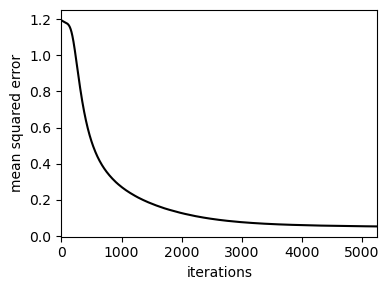

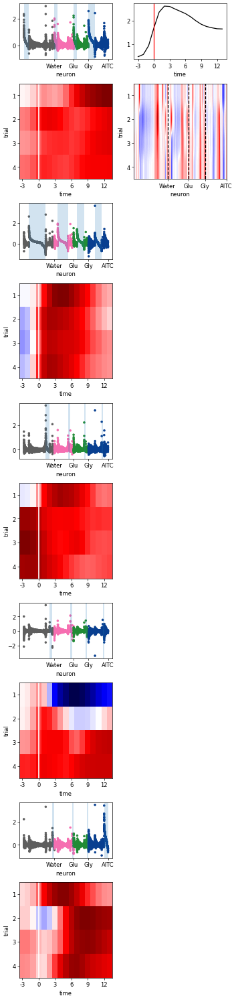

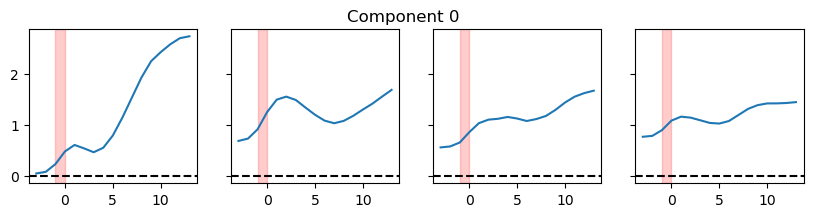

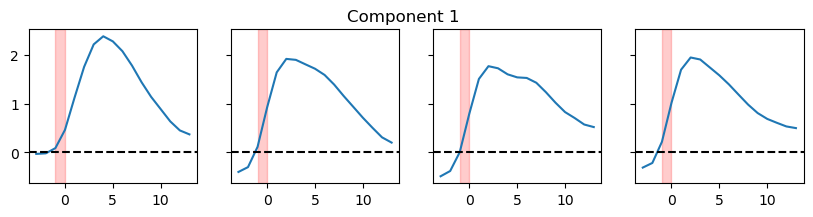

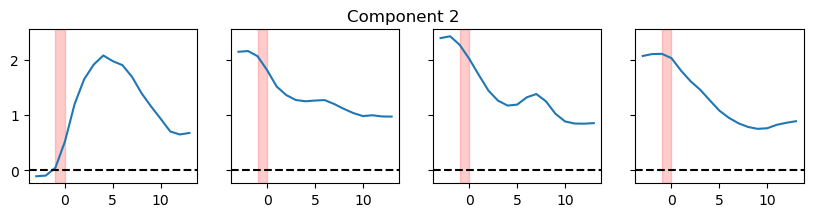

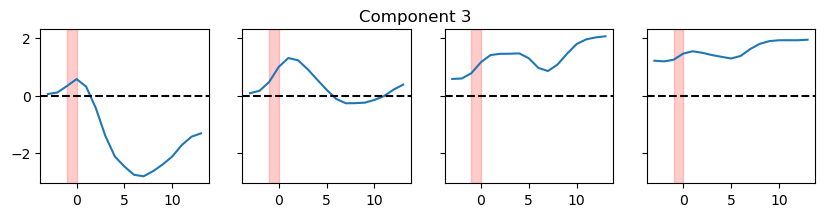

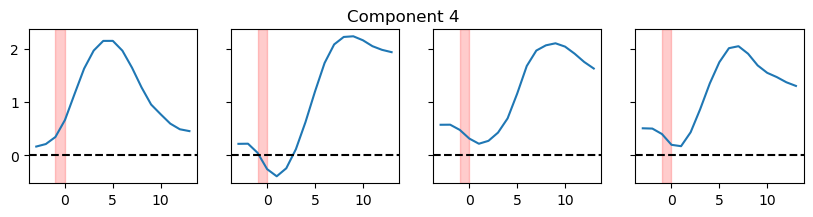

In [31]:
# Run models with specific number of components
decompose_new = True
savefig = True
num_components_list = [(0, 5, 1)]

if decompose_new:
	all_models = list()
	all_components = list()

for num_components in num_components_list:
	if decompose_new:
		components, model = slicetca.decompose(data,
											number_components=num_components,
											initialization="uniform",
											learning_rate=0.001,
											min_std=10**-4,
											max_iter=10000,
											seed=1)

		# For any component, if the sum of all the weights is negative, flip the signs by multiplying the factors with -1
		for c, comp in enumerate(components):
			for i, weights in enumerate(comp[0]):  # iterate over weights of different components
				if np.sum(weights) < 0:
					components[c][0][i] *= -1  # Multiply vector
					components[c][1][i] *= -1  # Multiply matrix

		model.set_components(components)

		all_models.append(model)
		all_components.append(components)

	plt.figure(figsize=(4,3), dpi=100)
	plt.plot(model.losses, 'k')
	plt.xlabel('iterations')
	plt.ylabel('mean squared error')
	plt.xlim(0,len(model.losses))
	plt.tight_layout()

	if region == "vagal":
		# Vagal neurons are parsed out by regions at the lowest level
		sort_idxs = last_region_idxs
	elif region == "hindbrain":
		# Hindbrain neurons are parsed out by stimuli at the lowest level
		sort_idxs = last_stimulus_idxs

	if num_components[0] != 0:
		# we sort the neurons of the trial slices according to their peak activity in the first slice.
		trial_colors = np.array([matplotlib.cm.get_cmap('Reds')(np.mod((i + 3*np.pi)/(np.pi * 2),1))[:3] for i in np.arange(4)])
		final_sorting_idx = order_by_trial_components(components, stimulus_region_sorting, sort_idxs)

	elif num_components[1] != 0:
		final_sorting_idx, last_component_idxs_combined = order_by_neuron_components(components, stimulus_region_sorting, sort_idxs)
	
	else:
		final_sorting_idx = np.array(stimulus_region_sorting)

	if region == "vagal":
		ticks = np.append(last_region_idxs, len(regions[0]))
		tick_labels = np.array([["L", "R"] for _ in range(int(len(ticks)/2))]).flatten()
	elif region == "hindbrain":
		ticks = np.append(last_stimulus_idxs, len(stimuli[0]))
		tick_labels = np.array(["Water", "Glu", "Gly", "AITC"])
			
	# call plotting function, indicating index for sorting trials and colors for different angles as well as time
	axes = slicetca.plot(model,
				variables=("trial", "neuron", "time"),
				colors=(None, region_colors, None), # we only want the trials to be colored
				ticks=(np.arange(4), ticks, np.arange(0, 16, 3)), # we only want to modify the time ticks
				tick_labels=(np.arange(1, 5), tick_labels, np.arange(-3, 13, 3)),
				sorting_indices=(np.arange(4), final_sorting_idx, None),
				quantile=0.99)
	
	# Graphics for trial components
	for a, ax in enumerate(axes[0][1]):
		ax.axvline(3, color="white")  # add the injection line on the slice

		# separate the stimuli
		# for idx in last_indices[:-1]:
		# 	ax.axhline(idx+1, linestyle="dashed", color="white")
		
		# connect the trial dots
		axes[0][0][a].plot(np.arange(4), components[0][0][a], color="tab:red")
	
	# Graphics for neuron components
	for a, ax in enumerate(axes[1][1]):  # for each neuron component
		ax.axvline(3, color="white", linewidth=2)  # add the injection line on the slice

		sorted_components = components[1][0][:, final_sorting_idx]

		if region == "vagal":
			classified_neurons, classified_neuron_idxs = get_classified_neurons(sorted_components, last_component_idxs_combined, last_region_idxs)
		elif region == "hindbrain":
			classified_neurons, classified_neuron_idxs = get_classified_neurons(sorted_components, last_component_idxs_combined, last_stimulus_idxs)

		starts = np.append(classified_neuron_idxs[a][0], classified_neuron_idxs[a][np.where(np.diff(classified_neuron_idxs[a]) != 1)[0] + 1])
		stops = np.append(classified_neuron_idxs[a][np.where(np.diff(classified_neuron_idxs[a]) != 1)], classified_neuron_idxs[a][-1])

		for start, stop in zip(starts, stops):
			axes[1][0][a].axvspan(start, stop, alpha=0.2)

	# Graphics for time components
	for a, ax in enumerate(axes[2][0]):
		ax.axvline(3, color="red")  # add the injection line on the time components

		# separate the stimuli
		for idx in ticks[:-1]:
			axes[2][1][a].axvline(idx, linestyle="dashed", color="black")

	if savefig:
		plt.savefig(tank.data_paths["figures"].joinpath(f"{num_components}_components.pdf"), transparent=True)

	for c, comp in enumerate(components[1][1]):
		fig, axs = plt.subplots(1, components[1][1].shape[1], sharex=True, sharey=True, figsize=(10, 2))
		for p, pulse in enumerate(comp):
			axs[p].plot(np.arange(-3, 14), pulse)
			axs[p].axhline(0, ls="dashed", color="black")
			axs[p].axvspan(-1, 0, color="red", alpha=0.2)
		fig.suptitle(f"Component {c}")

In [32]:
num_components_list

[(0, 5, 1)]

In [33]:
# Sort the smoothed and raw data
sorted_data = neural_data[:, final_sorting_idx, :]
sorted_raw_data = raw_neural_data[:, final_sorting_idx, :]
sorted_df = df.reindex(final_sorting_idx).reset_index().drop(columns=["index"])

In [34]:
# Select the components with the index
num_comp_idx = 0
print(num_components_list[num_comp_idx])
sorted_components = all_components[num_comp_idx][1][0][:, final_sorting_idx]

(0, 5, 1)


/Users/minelarinel/mambaforge/envs/mescore/lib/python3.10/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/minelarinel/mambaforge/envs/mescore/lib/python3.10/site-packages/numpy/core/_methods.py:195: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


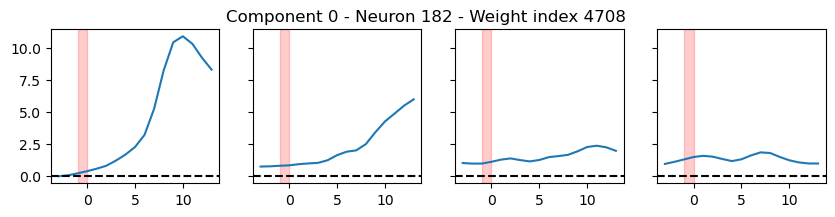

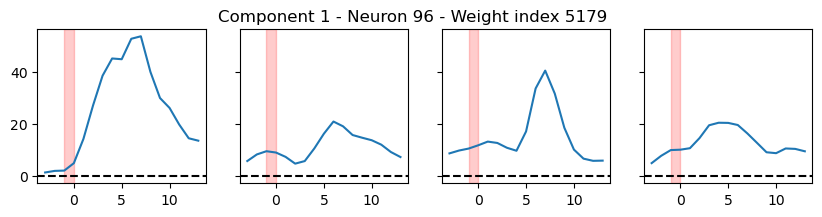

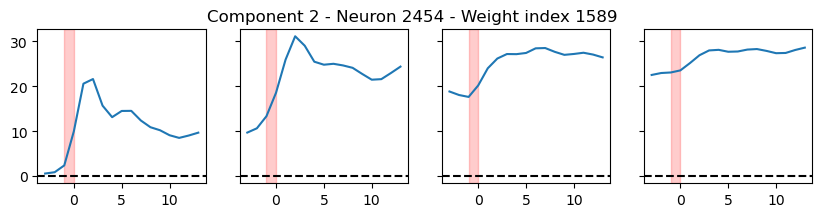

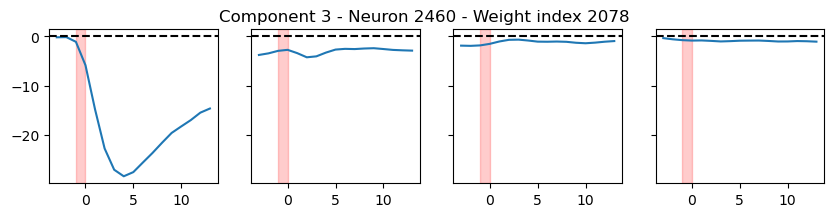

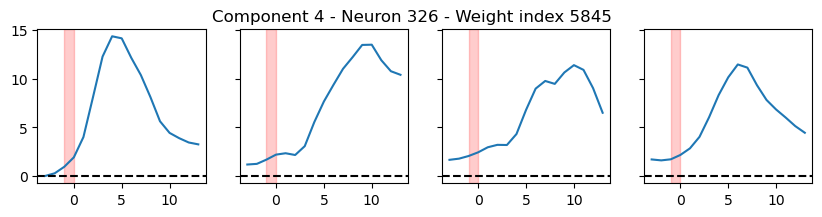

In [35]:
# Plot the neuron with the highest weight for each component
plot_top_n_neurons(sorted_components, sorted_data, classified_neurons, classified_neuron_idxs, final_sorting_idx, N_neurons=1)

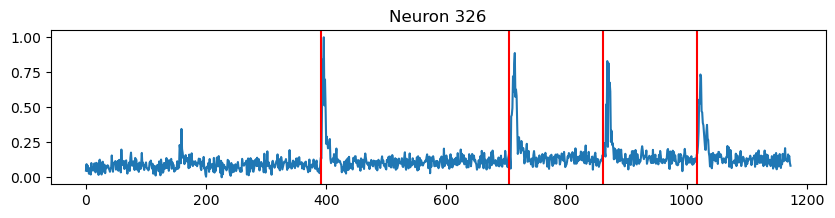

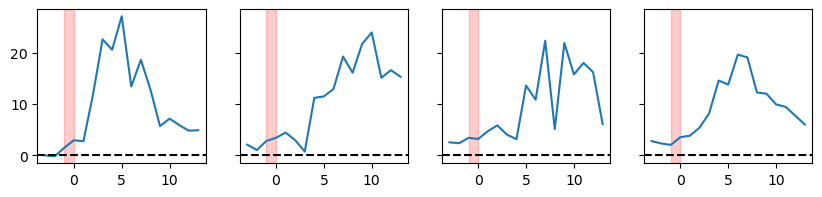

In [40]:
plt_neuron = 326

plt.figure(figsize=(10, 2))
plt.plot(df.loc[plt_neuron, "raw_norm_temporal"])
for i in df.loc[plt_neuron, "pulse_frames"]:
    plt.axvline(i, color='red')
plt.title(f"Neuron {plt_neuron}")
    
x, traces = get_traces(df.loc[plt_neuron:plt_neuron+2], pre_frame_num=pre_frame_num, post_frame_num=post_frame_num, normalize=normalize,
               normalize_by_first=normalize_by_first, key=key, only_responsive=False)

fig, axs = plt.subplots(1, len(df.loc[plt_neuron, "pulse_frames"]), sharex=True, sharey=True, figsize=(10, 2))
for p, t in enumerate(traces[:len(df.loc[plt_neuron, "pulse_frames"])]):
	axs[p].plot(np.arange(-3, 14), t)
	axs[p].axhline(0, ls="dashed", color="black")
	axs[p].axvspan(-1, 0, color="red", alpha=0.2)

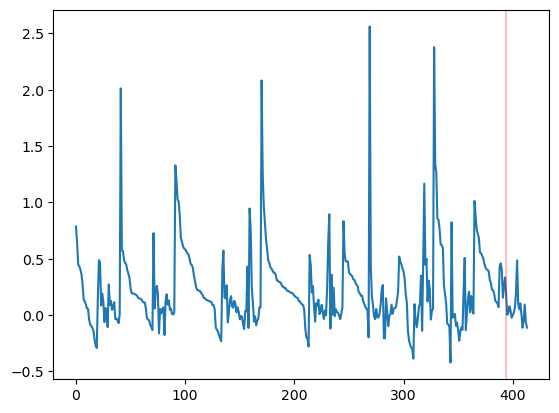

In [1356]:
plt.plot(sorted_components[0])
plt.axvline(394, color="red", alpha=0.25)

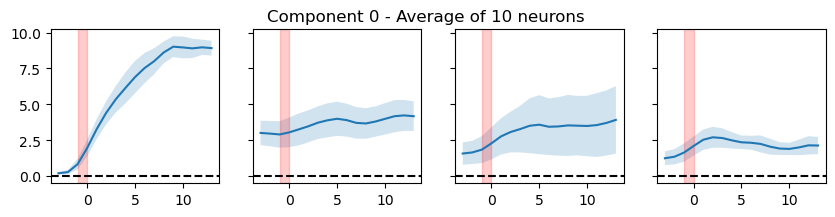

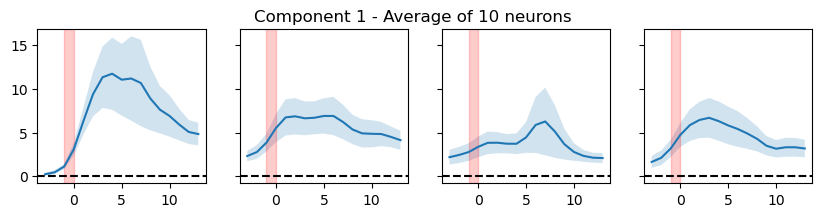

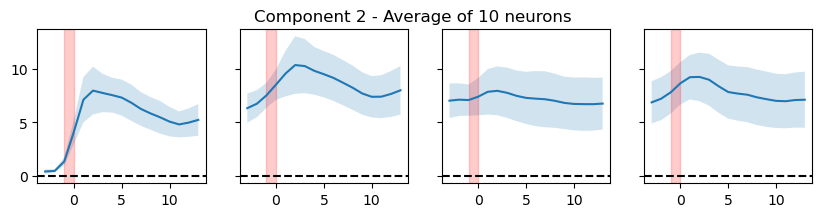

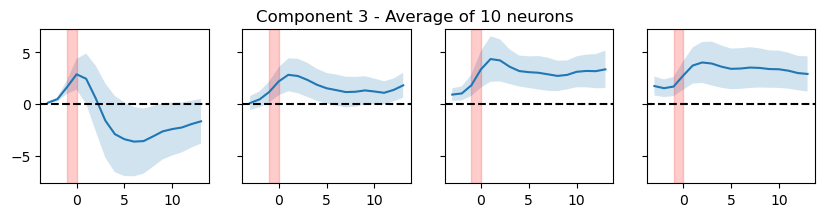

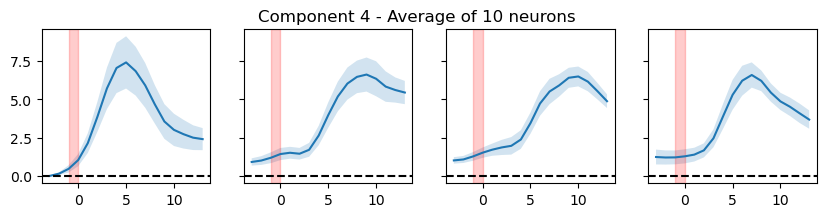

In [41]:
# Plot the average trace of the top N neurons for each component (SMOOTHED DATA)
N_neurons = 10  # number of top neurons to average over

plot_top_n_neurons(sorted_components, sorted_data, classified_neurons, classified_neuron_idxs, final_sorting_idx, N_neurons=N_neurons)

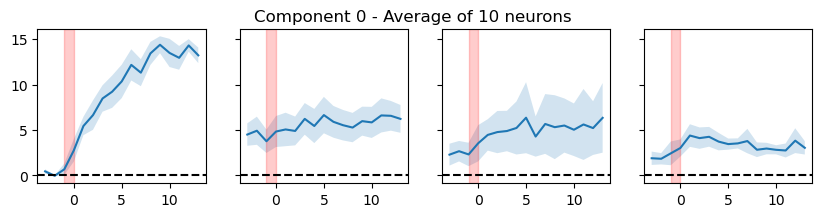

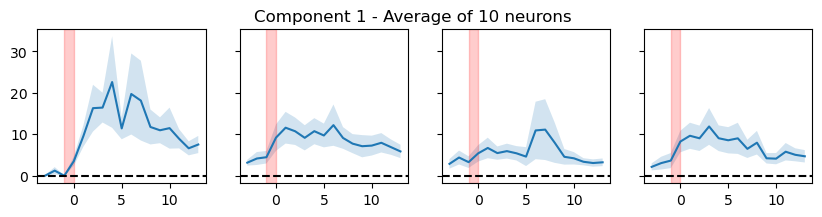

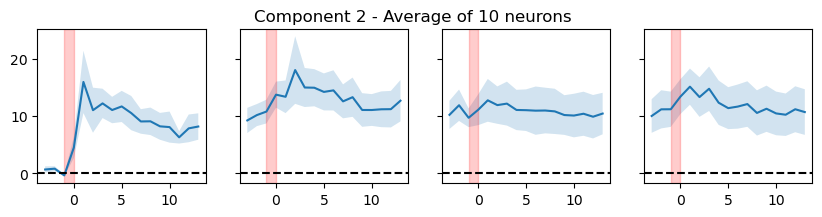

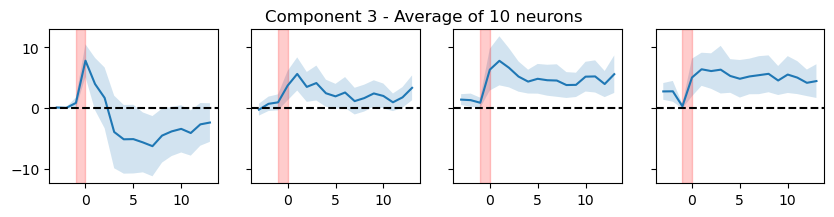

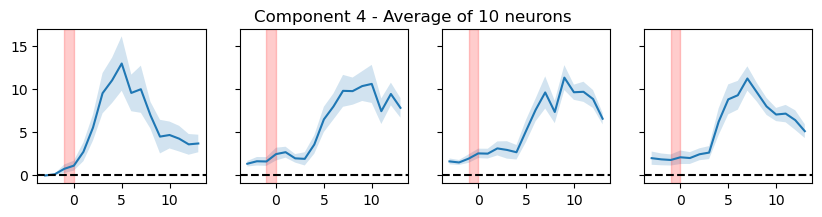

In [42]:
# Plot the average trace of the top N neurons for each component (RAW DATA)
N_neurons = 10  # number of top neurons to average over

plot_top_n_neurons(sorted_components, sorted_raw_data, classified_neurons, classified_neuron_idxs, final_sorting_idx, N_neurons=N_neurons)

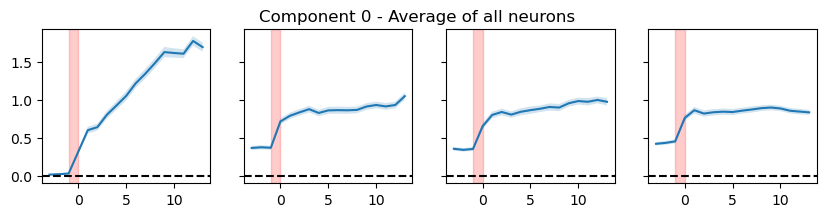

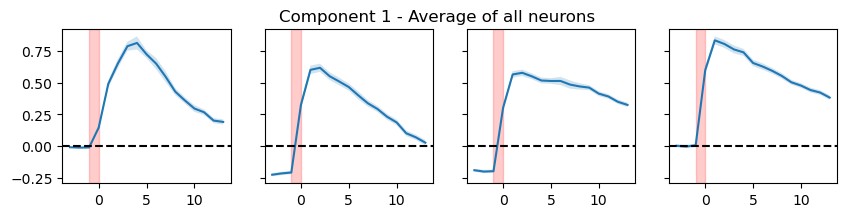

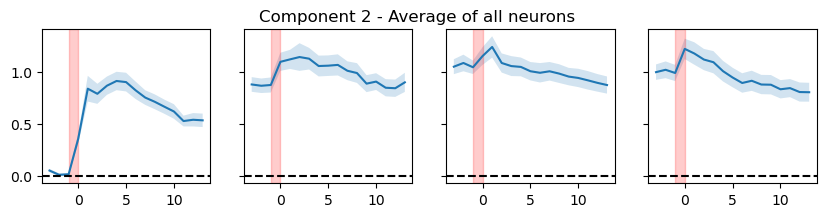

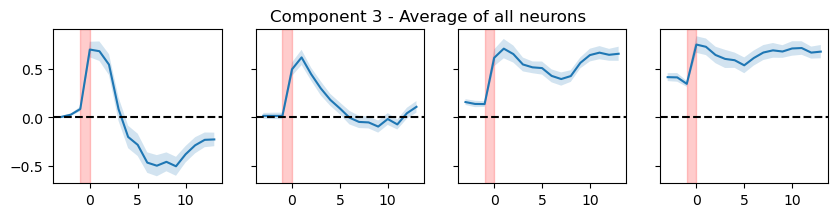

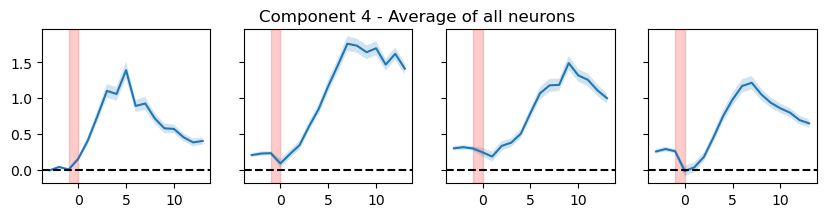

In [47]:
# Plot the average trace of all classified neurons for each component (RAW DATA)
plot_all_classified_neurons(sorted_components, sorted_raw_data, classified_neurons, classified_neuron_idxs, savefig=False, save_folder=tank.data_paths["figures"])

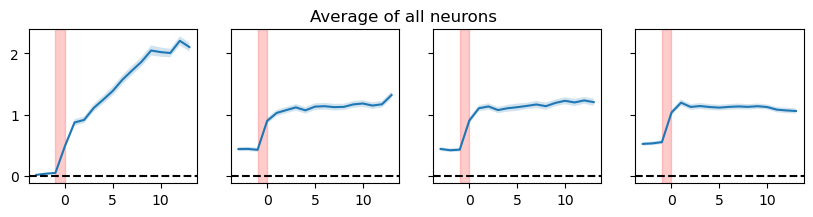

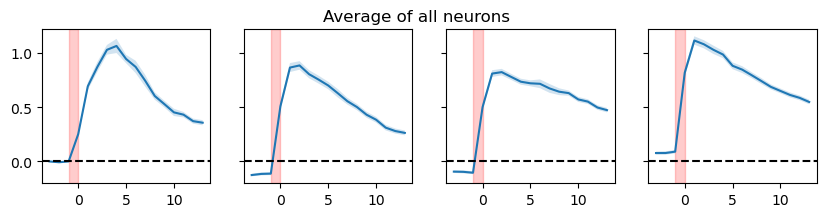

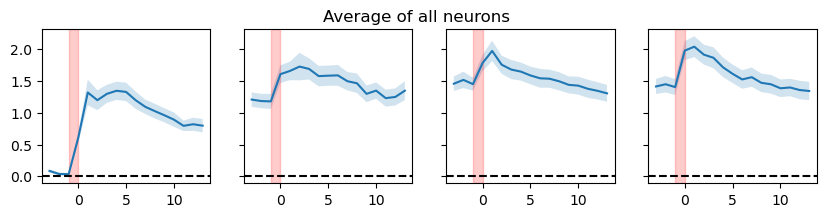

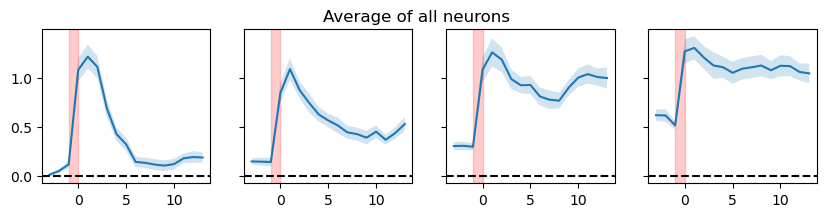

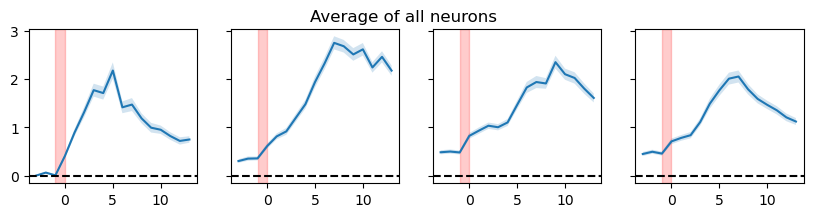

In [49]:
# Plot only the positive-weighted neurons
for component in range(sorted_components.shape[0]):
	plot_all_neurons(sorted_raw_data[:, classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :])
	plt.savefig(tank.data_paths["figures"].joinpath(f"component{component}_avg_pos_classified.pdf"), transparent=True)

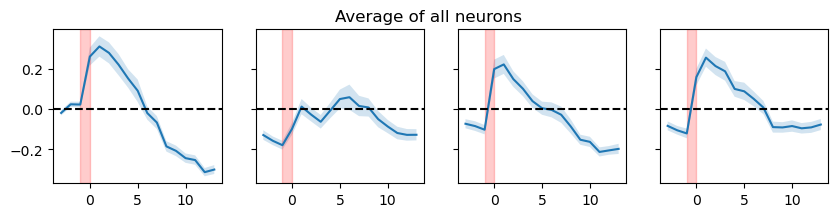

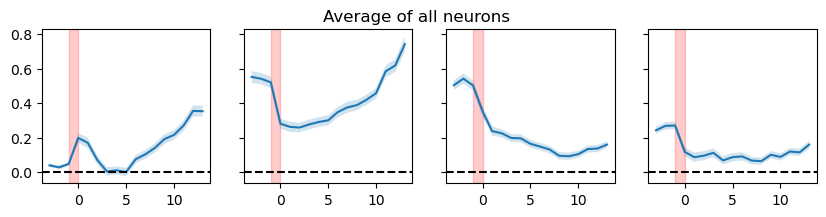

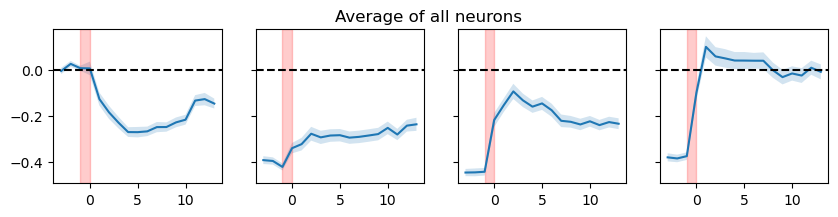

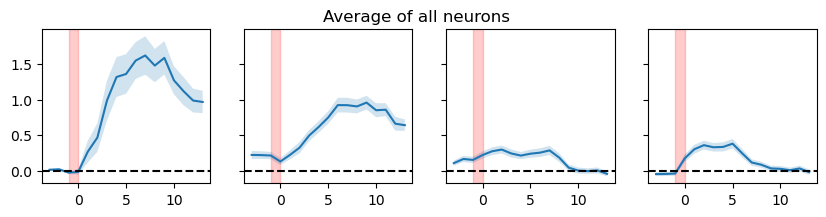

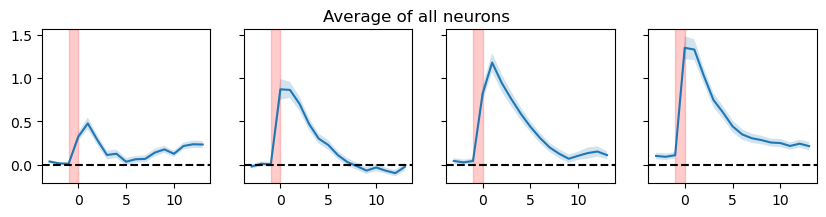

In [51]:
# Plot only the negative-weighted neurons
for component in range(sorted_components.shape[0]):
	plot_all_neurons(sorted_raw_data[:, classified_neuron_idxs[component][np.where(classified_neurons[component] < 0)], :])
	plt.savefig(tank.data_paths["figures"].joinpath(f"component{component}_avg_neg_classified.pdf"), transparent=True)

In [1704]:
# Returns the weights of only the clustered neurons
all_weights = get_clustered_component_weights(sorted_components, classified_neurons, classified_neuron_idxs, regions[0][final_sorting_idx], stimuli[0][final_sorting_idx])

In [137]:
# Returns the weights of all neurons per component
all_weights = get_all_component_weights(sorted_components, regions[0][final_sorting_idx], stimuli[0][final_sorting_idx])

In [142]:
c = 4  # component you want to copy

if region == "vagal":
	test = all_weights[c].transpose()
	L_col = list()
	R_col = list()
	for t in test.index:
		if t.endswith("L"):
			L_col.append(test.loc[t, :])
		elif t.endswith("R"):
			R_col.append(test.loc[t, :])
			
	L_df = pd.DataFrame(np.vstack(L_col))
	R_df = pd.DataFrame(np.vstack(R_col))

	final_df = pd.concat([L_df, R_df], axis=1)
	final_df.rename(index={0: "Water", 1: "Glu", 2: "Gly", 3: "AITC"}, inplace=True)
	final_df.to_clipboard()
	print(f"Number of columns: {test.shape[1]}")

elif region == "hindbrain":
	all_weights[c].to_clipboard()

In [147]:
# Returns the percentages of clustered neurons per component
all_percentages = get_clustered_component_percentages(sorted_df, classified_neuron_idxs, regions[0][final_sorting_idx], stimuli[0][final_sorting_idx])

In [153]:
c = 4  # component you want to copy

if region == "vagal":
	test = all_percentages[c].transpose()
	L_col = list()
	R_col = list()
	for t in test.index:
		if t.endswith("L"):
			L_col.append(test.loc[t, :])
		elif t.endswith("R"):
			R_col.append(test.loc[t, :])
			
	L_df = pd.DataFrame(np.vstack(L_col))
	R_df = pd.DataFrame(np.vstack(R_col))

	final_df = pd.concat([L_df, R_df], axis=1)
	final_df.rename(index={0: "Water", 1: "Glu", 2: "Gly", 3: "AITC"}, inplace=True)
	print(f"Number of columns: {test.shape[1]}")

	final_df.to_clipboard()

elif region == "hindbrain":
	all_percentages[c].to_clipboard()

In [28]:
num_components_list

[(0, 2, 0),
 (0, 2, 1),
 (0, 3, 0),
 (0, 3, 1),
 (0, 4, 0),
 (0, 4, 1),
 (0, 5, 0),
 (0, 5, 1),
 (0, 5, 2),
 (0, 6, 0),
 (0, 6, 1),
 (0, 6, 2),
 (0, 7, 0),
 (0, 7, 1),
 (0, 7, 2),
 (0, 7, 3)]

Text(0.5, 0, 'Sparsity')

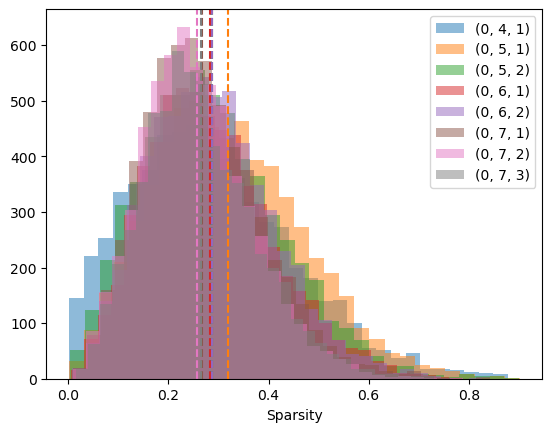

In [29]:
# Plot the histogram of sparsity of each neuron
num_components_subset = [5, 7, 8, 10, 11, 13, 14, 15]  # specific indices to plot (5, 10)

for c, nc in enumerate(num_components_subset):
	components = all_components[nc]
	if components[1][0].shape[0] > 1:  # only look at sparsity if there are more than 1 neuron components
		sorted_components = components[1][0][:, final_sorting_idx]
		
		sparsities = list()
		for n in range(sorted_components.shape[1]):
			X = sorted_components[:, n]
			sparsity = (np.sqrt(len(X)) - np.sum(np.abs(X)) / np.sqrt(np.sum(X**2))) / (np.sqrt(len(X)) - 1)
			sparsities.append(sparsity)
		
		plt.hist(sparsities, bins=30, label=str(num_components_list[nc]), color=plt.rcParams['axes.prop_cycle'].by_key()['color'][c], alpha=0.5)
		plt.axvline(np.mean(sparsities), linestyle="dashed", color=plt.rcParams['axes.prop_cycle'].by_key()['color'][c])

plt.legend()
plt.xlabel("Sparsity")

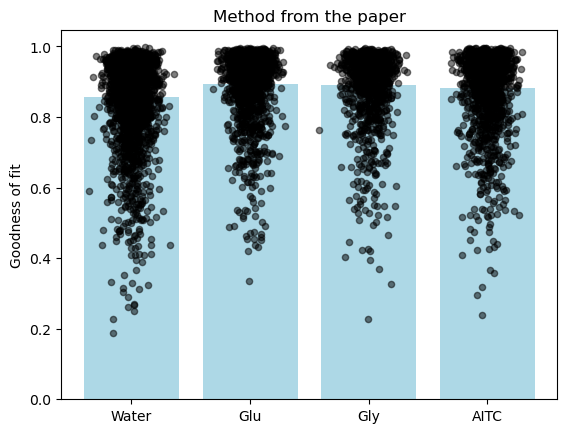

In [43]:
# Calculate and plot goodness of fit (by the paper method)
savefig = True

# Reconstruct using all the components
reconstructions_full = list()
for model in all_models:
	reconstruction_full = model.construct().numpy(force=True)
	reconstructions_full.append(reconstruction_full)

for reconst in reconstructions_full:
	gofs = list()
	# Calculate goodness of fit for each neuron
	for n in range(reconst.shape[1]):
		a = np.sum([(data[k, n, t] - reconst[k, n, t]) ** 2 for t in range(reconst.shape[2]) for k in range(reconst.shape[0])])
		b = np.sum([data[k, n, t] ** 2 for t in range(reconst.shape[2]) for k in range(reconst.shape[0])])
		gof = 1 - (a/b)  # Goodness of fit
		gofs.append(gof)

	# Plot goodness of fit
	
	bar_values = list()
	dot_values = list()

	if region == "vagal":
		categories = ["Water_L", "Water_R", "Glu_L", "Glu_R", "Gly_L", "Gly_R", "AITC_L", "AITC_R"]
	elif region == "hindbrain":
		categories = ["Water", "Glu", "Gly", "AITC"]

	for s, stim_stop_idx in enumerate(sort_idxs):
		if s == 0:
			bar_values.append(np.mean(gofs[:stim_stop_idx+1]))
			dot_values.append(gofs[:stim_stop_idx+1])
		else:
			bar_values.append(np.mean(gofs[sort_idxs[s-1]+1:stim_stop_idx+1]))
			dot_values.append(gofs[sort_idxs[s-1]+1:stim_stop_idx+1])

	bar_values.append(np.mean(gofs[sort_idxs[-1]+1:]))
	dot_values.append(gofs[sort_idxs[-1]+1:])

	# Create bar plot
	fig, ax = plt.subplots()
	ax.bar(categories, bar_values, color='lightblue')

	# Add individual dots
	for i, cat in enumerate(categories):
		x = [i] * len(dot_values[i])
		jitter(x, dot_values[i], color='black', alpha=0.5)

	ax.set_ylabel("Goodness of fit")
	# ax.axhline(0.5, linestyle="dashed", color="red")
	ax.set_title("Method from the paper")

	if savefig:
		plt.savefig(tank.data_paths["figures"].joinpath("goodnessoffit_papermethod.pdf"), transparent=True)

In [44]:
sort_idxs

array([2228, 3620, 4707])

In [ ]:
for s, stim_stop_idx in enumerate(sort_idxs):
	if s == 0:
		bar_values.append(np.mean(gofs[:stim_stop_idx+1]))
		dot_values.append(gofs[:stim_stop_idx+1])
	else:
		bar_values.append(np.mean(gofs[sort_idxs[s-1]+1:stim_stop_idx+1]))
		dot_values.append(gofs[sort_idxs[s-1]+1:stim_stop_idx+1])

In [1835]:
s = 7

gofs[sort_idxs[-1]+1:]

[0.8776457607746124,
 0.9308946430683136,
 0.973723417147994,
 0.8967473059892654,
 0.9604306742548943,
 0.9959642086178064,
 0.9784665480256081,
 0.9702825862914324,
 0.9106137007474899,
 0.9015072286128998,
 0.9705417156219482,
 0.8741216212511063,
 0.9094124436378479,
 0.740324854850769,
 0.8984171748161316,
 0.929538793861866,
 0.8702426999807358,
 0.7416068315505981,
 0.9623428396880627,
 0.3237837553024292,
 0.9835952557623386,
 0.9669883139431477,
 0.9654502496123314,
 0.9956041495315731,
 0.8892553597688675,
 0.9722718298435211,
 0.9864161945879459,
 0.9939025961793959,
 0.9743156749755144,
 0.8973493278026581,
 0.8250018209218979,
 0.9311313852667809,
 0.9511520899832249,
 0.9428942799568176,
 0.9693048652261496,
 0.8992080092430115,
 0.7917048037052155,
 0.8197452574968338,
 0.8161916583776474,
 0.7978272289037704,
 0.7791605144739151,
 0.8905648738145828,
 0.7969997376203537,
 0.8533240705728531,
 0.8124382793903351,
 0.782379686832428,
 0.8592493534088135,
 0.95057701319456

In [45]:
# Sort the reconstruction dataset
print(num_components_list[num_comp_idx])
sorted_reconst = reconstructions_full[num_comp_idx][:, final_sorting_idx, :]

(0, 5, 1)


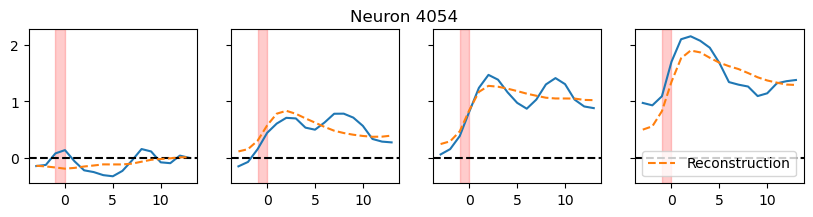

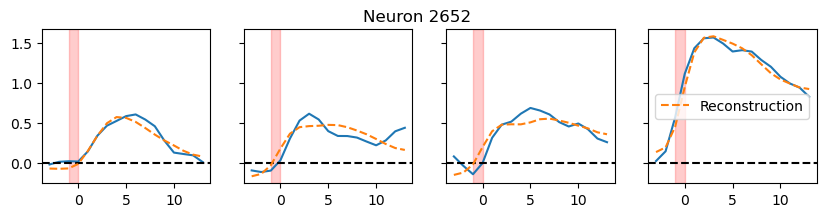

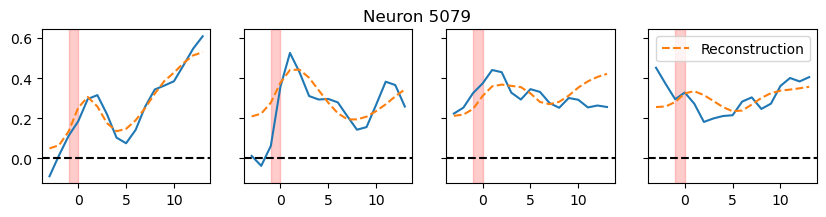

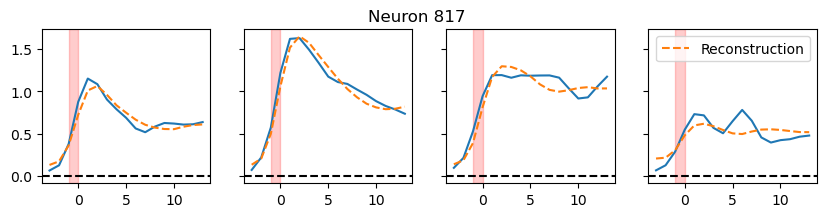

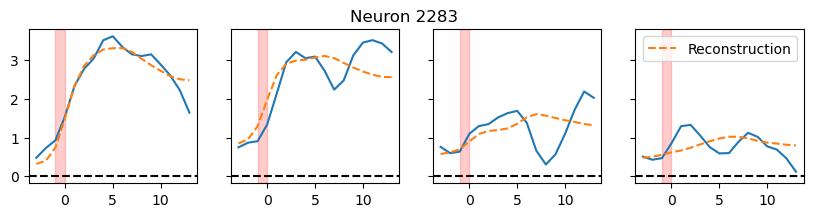

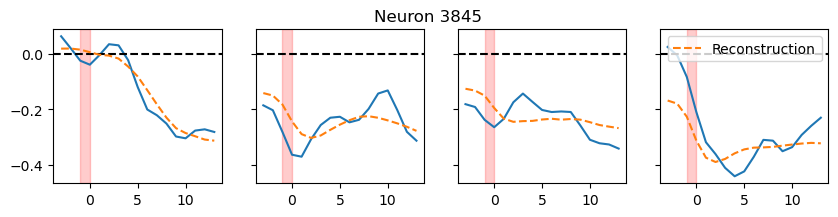

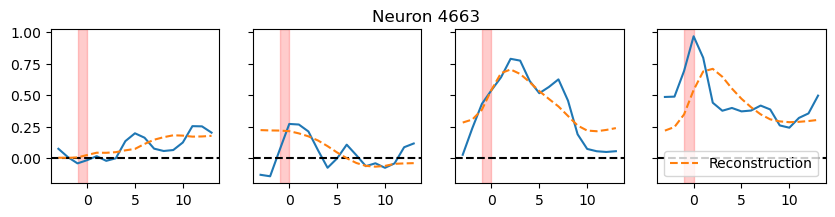

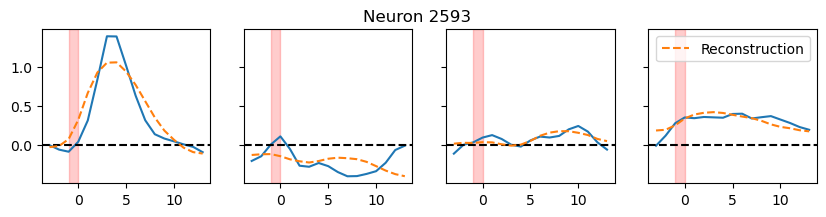

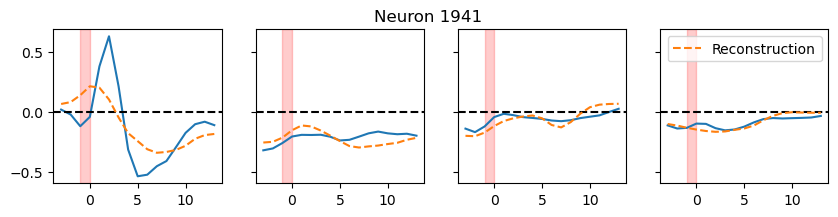

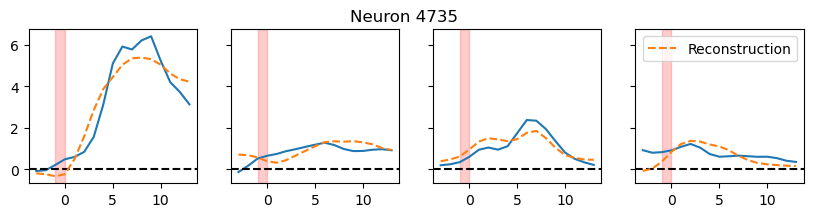

In [64]:
# Plot n randomly selected neurons
plot_random_neuron(sorted_data, n=10, sorted_reconst=sorted_reconst)

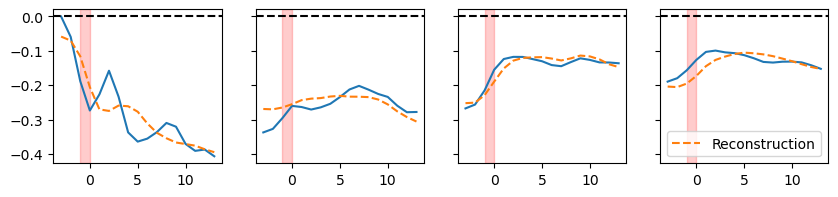

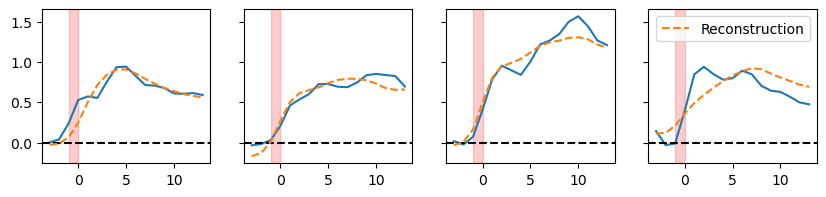

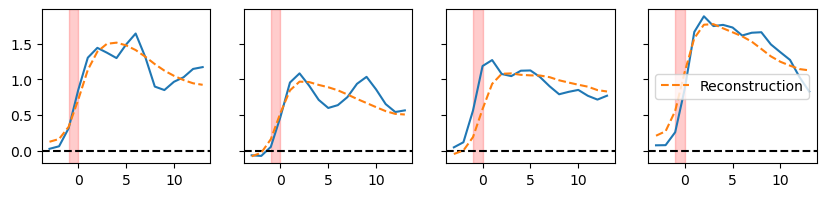

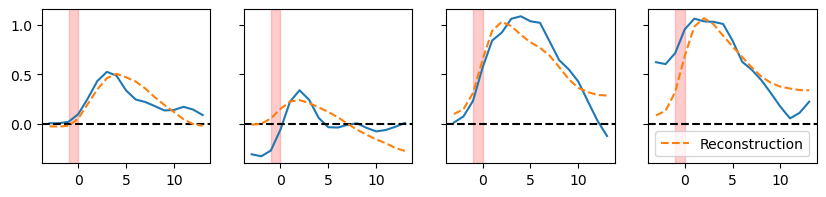

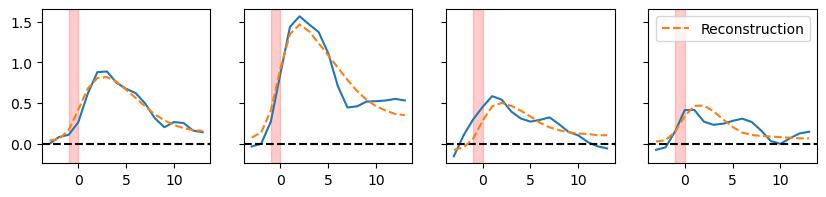

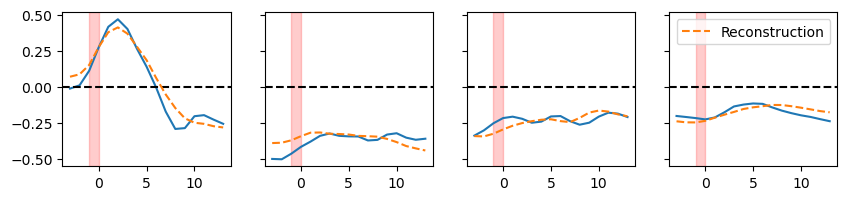

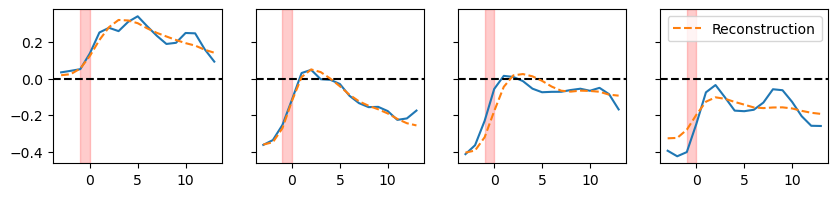

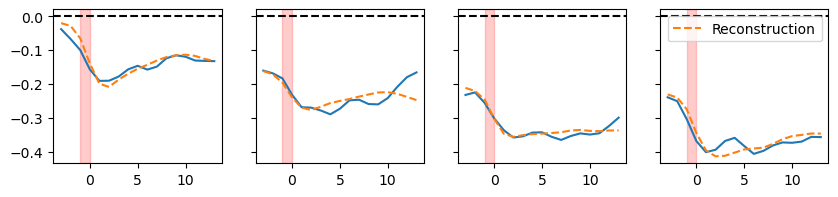

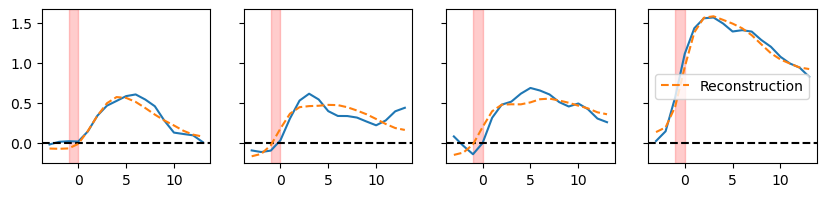

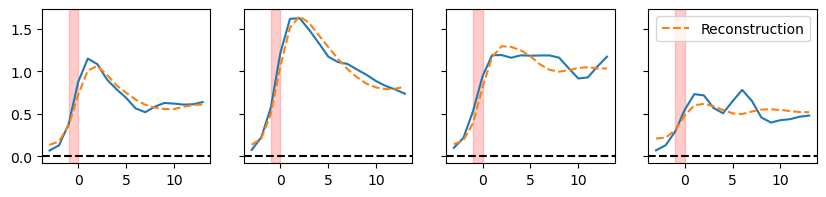

In [65]:
# Plot individual neuron traces
idxs = [1190, 3973, 575, 4137, 4041, 2950, 4105, 4481, 2652, 817] 
# 173 for activated, 291 for suppressed - VAGAL
# 2176 for activated, 800 for suppressed - HINDBRAIN

savefig = False

plot_neurons(sorted_data[:, idxs, :], sorted_reconst=sorted_reconst[:, idxs, :])
if savefig:
	plt.savefig(tank.data_paths["figures"].joinpath(f"{idxs}_neuron_traces_with_reconstruction.pdf"), transparent=True)

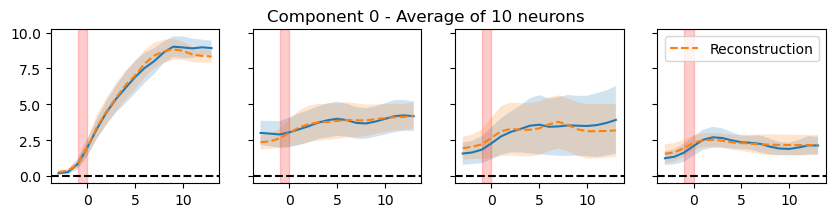

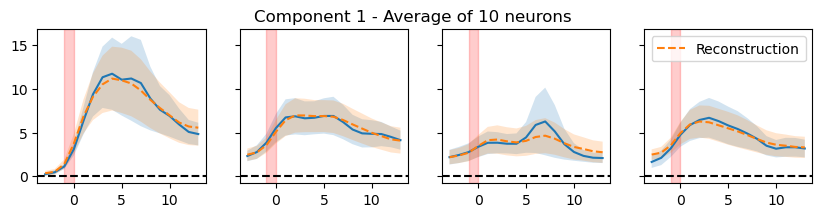

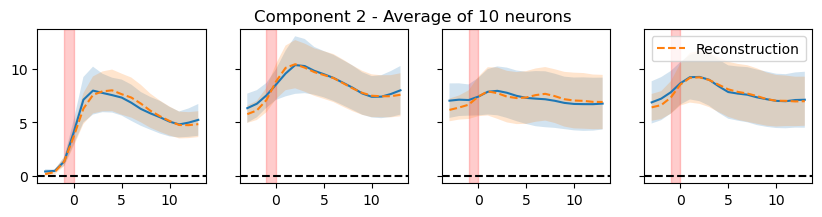

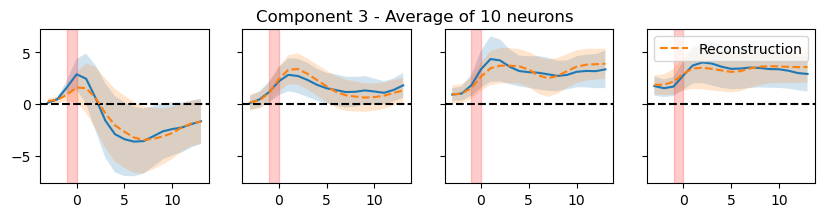

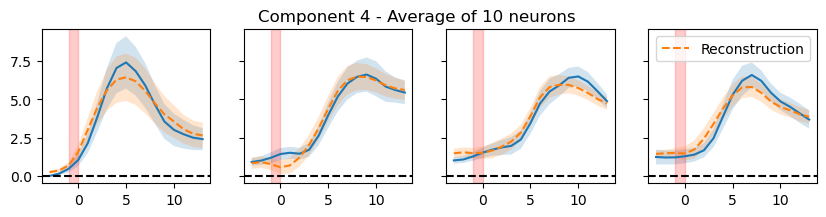

In [46]:
# Plot the average trace of the reconstruction of the top N neurons for each component
N_neurons = 10  # number of top neurons to average over

plot_top_n_neurons(sorted_components, sorted_data, classified_neurons, classified_neuron_idxs, final_sorting_idx, N_neurons=N_neurons, sorted_reconst=sorted_reconst)

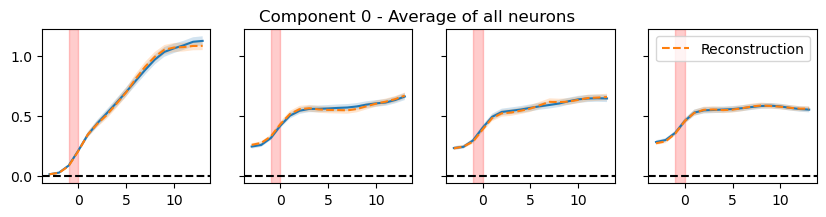

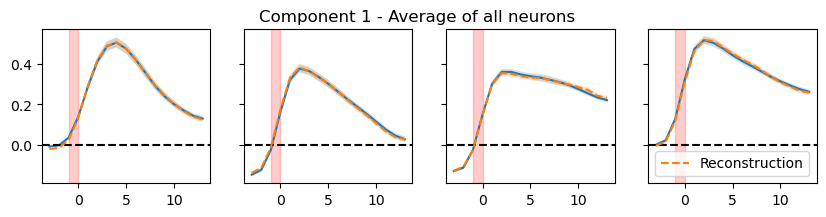

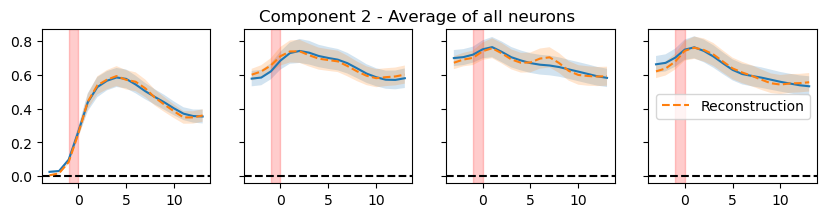

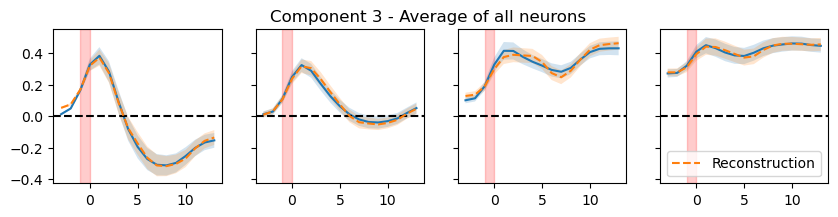

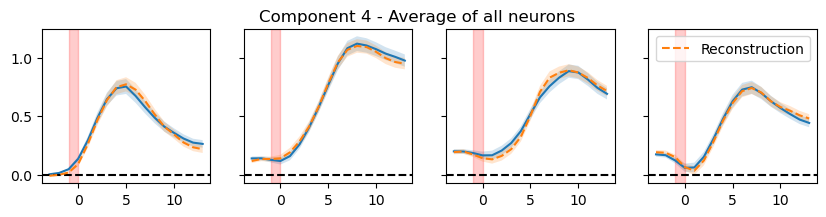

In [48]:
# Plot the average trace of all classified neurons for each component (RAW DATA)
plot_all_classified_neurons(sorted_components, sorted_data, classified_neurons, classified_neuron_idxs, sorted_reconst=sorted_reconst)

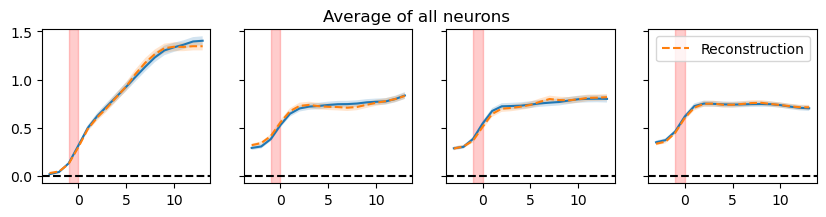

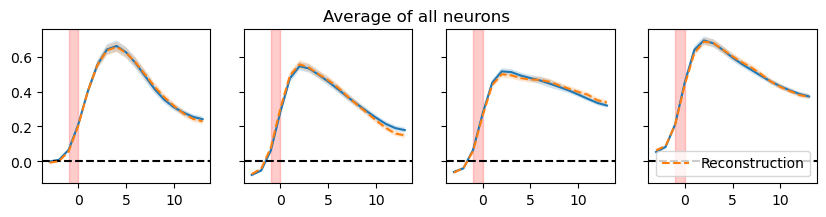

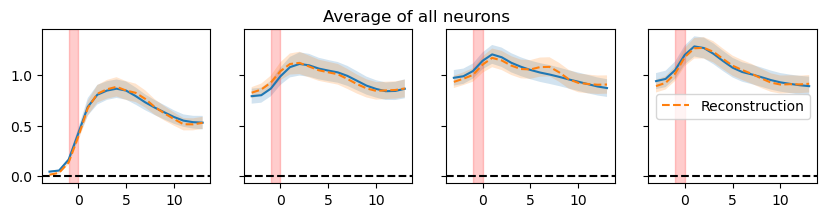

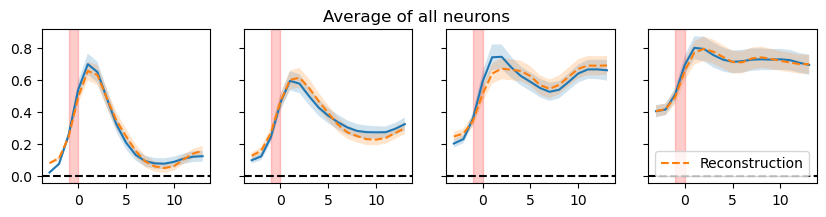

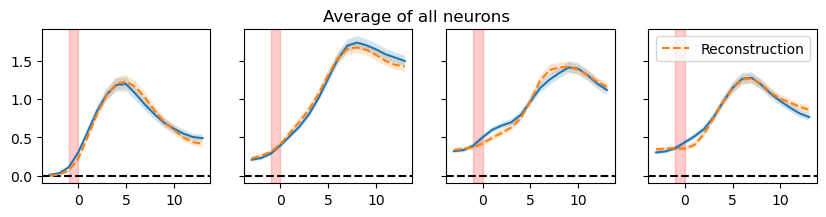

In [50]:
# Plot only the positive-weighted neurons
for component in range(sorted_components.shape[0]):
	plot_all_neurons(sorted_data[:, classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :],
				  sorted_reconst=sorted_reconst[:, classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :])

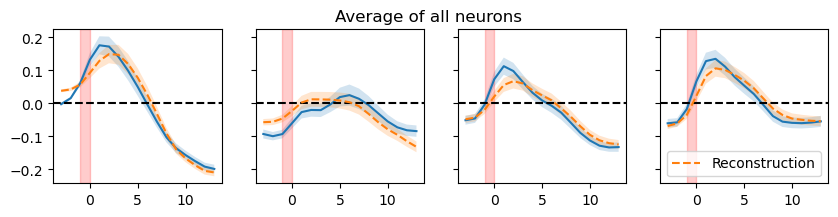

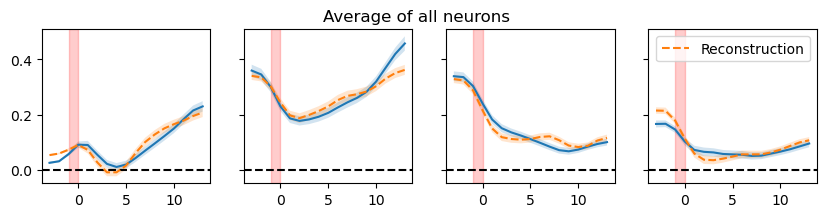

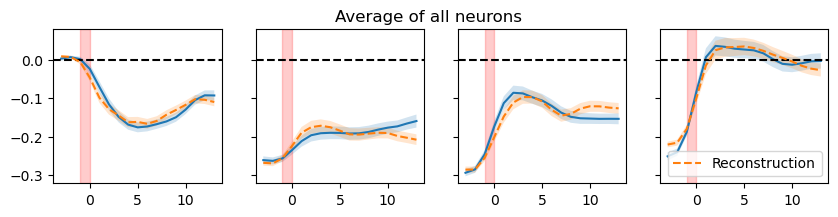

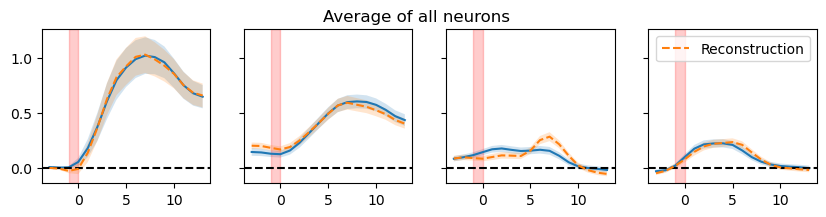

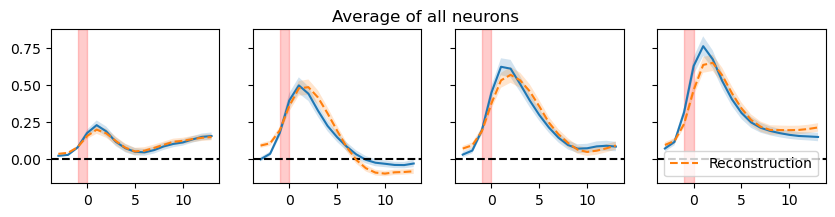

In [52]:
# Plot only the negative-weighted neurons
for component in range(sorted_components.shape[0]):
	plot_all_neurons(sorted_data[:, classified_neuron_idxs[component][np.where(classified_neurons[component] < 0)], :],
				  sorted_reconst=sorted_reconst[:, classified_neuron_idxs[component][np.where(classified_neurons[component] < 0)], :])

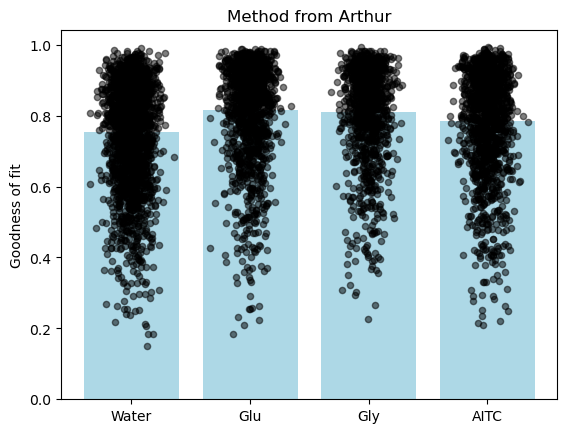

In [131]:
# Calculate and plot goodness of fit (by the second method from Arthur's email)

# Reconstruct using all the components
for reconst in reconstructions_full:
	arthur_gofs = list()
	# Calculate goodness of fit for each neuron
	for n in range(reconst.shape[1]):
		mse = np.mean([(data[k, n, t] - reconst[k, n, t]) ** 2 for t in range(reconst.shape[2]) for k in range(reconst.shape[0])])
		gof = 1 - (mse/np.var(neural_data[:, n, :]))  # Goodness of fit
		arthur_gofs.append(gof)

	# Plot goodness of fit
	bar_values = list()
	dot_values = list()

	if region == "vagal":
		categories = ["Water_L", "Water_R", "Glu_L", "Glu_R", "Gly_L", "Gly_R", "AITC_L", "AITC_R"]
	elif region == "hindbrain":
		categories = ["Water", "Glu", "Gly", "AITC"]

	for s, stim_stop_idx in enumerate(sort_idxs):
		if s == 0:
			bar_values.append(np.mean(arthur_gofs[:stim_stop_idx+1]))
			dot_values.append(arthur_gofs[:stim_stop_idx+1])
		else:
			bar_values.append(np.mean(arthur_gofs[sort_idxs[s-1]+1:stim_stop_idx+1]))
			dot_values.append(arthur_gofs[sort_idxs[s-1]+1:stim_stop_idx+1])

	bar_values.append(np.mean(arthur_gofs[sort_idxs[-1]+1:]))
	dot_values.append(arthur_gofs[sort_idxs[-1]+1:])

	# Create bar plot
	fig, ax = plt.subplots()
	ax.bar(categories, bar_values, color='lightblue')

	# Add individual dots
	for i, cat in enumerate(categories):
		x = [i] * len(dot_values[i])
		jitter(x, dot_values[i], color='black', alpha=0.5)

	ax.set_ylabel("Goodness of fit")
	# ax.axhline(0.5, linestyle="dashed", color="red")
	ax.set_title("Method from Arthur")


In [132]:
for i, num_components in enumerate(num_components_list):
    pickle.dump([all_components[i], all_models[i]], open(tank.folder_path.joinpath(f"{num_components}_comps_model.p"), "wb"))

#### Reconstruct the data from the fitted model

To reconstruct the approximated data tensor, you can simply call model.construct(). Don't forget to convert from torch to numpy: model.construct().numpy(force=True)

In [493]:
# reconstruct from all partitions
reconstruction_full = model.construct().numpy(force=True)

# reconstruct from the trial-slicing partition (i.e., sum of all trial-slicing component reconstructions)
reconstruction_trial_slicing = model.construct_single_partition(partition=0).numpy(force=True)

# reconstruct from the neuron-slicing partition (i.e., sum of all neuron-slicing component reconstructions)
reconstruction_neuron_slicing = model.construct_single_partition(partition=1).numpy(force=True)

# construct from the time-slicing partition (i.e., sum of all time-slicing component reconstructions)
reconstruction_time_slicing = model.construct_single_partition(partition=2).numpy(force=True)

/var/folders/48/8y2gqcvx5q5575kwkzngl6qw0000gn/T/ipykernel_46838/606457519.py:19: RuntimeWarning: invalid value encountered in divide
  reconstruction_trial_slicing = np.array([d / d.max() for d in np.array([d - d.min() for d in reconstruction_trial_slicing])])


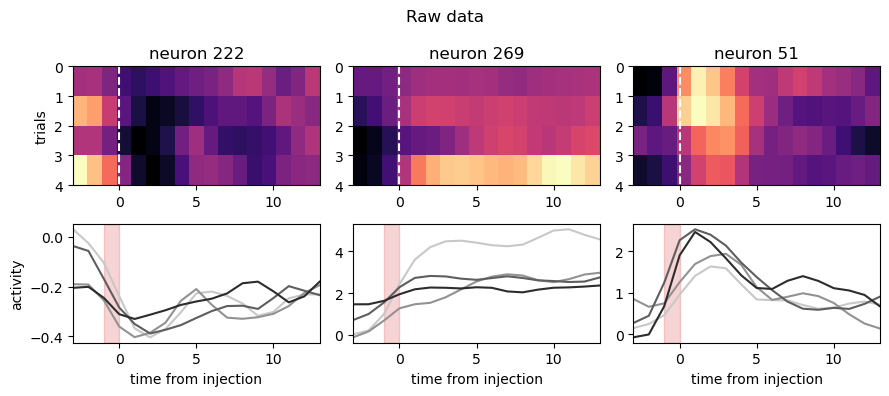

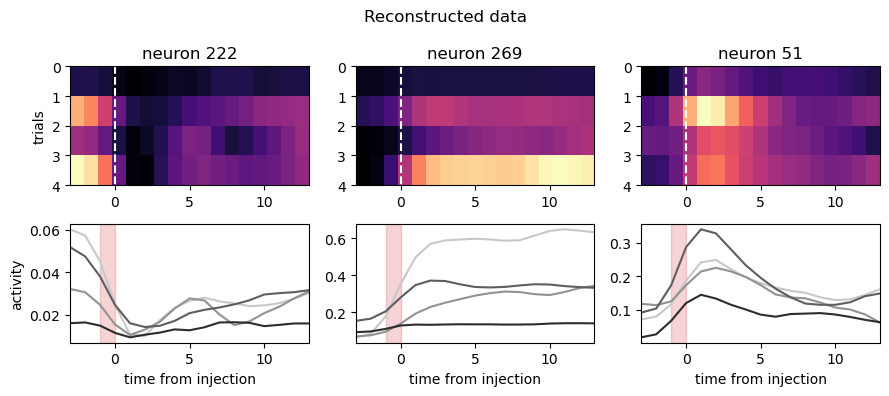

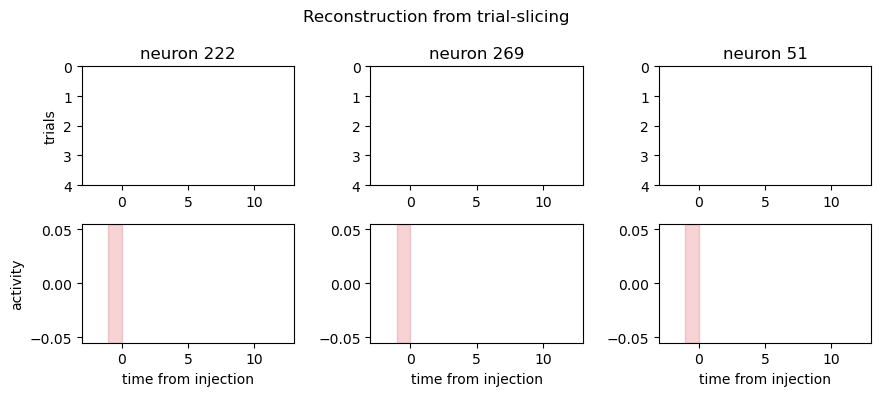

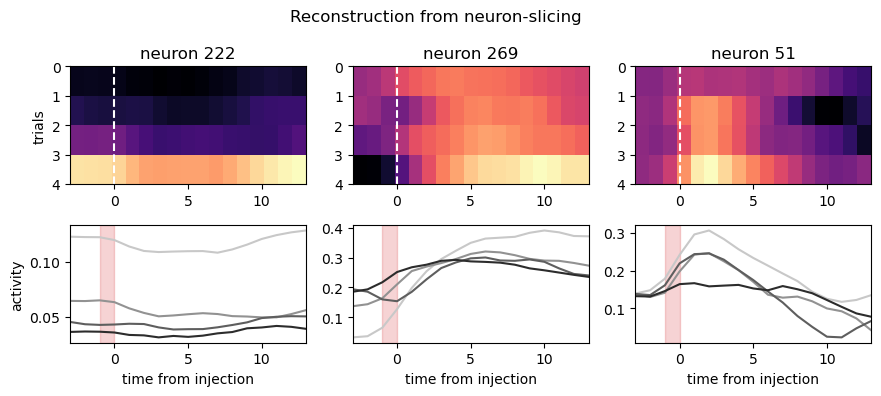

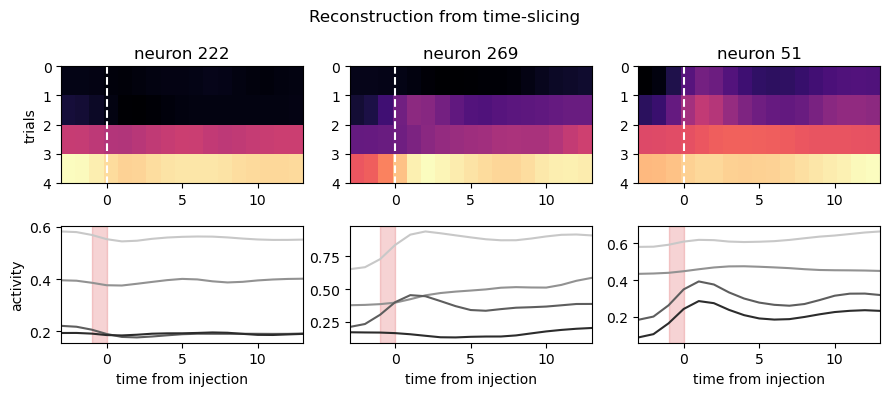

In [494]:
if region == "vagal":
	neurons = [df[(df.fish_id == 29) & (df.plane == 2) & (df.neuron == 15)].index.values[0], 
			df[(df.fish_id == 30) & (df.plane == 0) & (df.neuron == 8)].index.values[0], 
			df[(df.fish_id == 39) & (df.plane == 0) & (df.neuron == 1)].index.values[0]]

elif region == "hindbrain":
	neurons = [df[(df.fish_id == 67) & (df.plane == 0) & (df.neuron == 130)].index.values[0], 
			df[(df.fish_id == 67) & (df.plane == 3) & (df.neuron == 699)].index.values[0], 
			df[(df.fish_id == 49) & (df.plane == 4) & (df.neuron == 1026)].index.values[0]]

colors = {
	0: "#C8C8C8",
	1: "#929292",
	2: "#5E5E5E",
	3: "#2C2C2C"
}

reconstruction_full = np.array([d / d.max() for d in np.array([d - d.min() for d in reconstruction_full])])
reconstruction_trial_slicing = np.array([d / d.max() for d in np.array([d - d.min() for d in reconstruction_trial_slicing])])
reconstruction_neuron_slicing = np.array([d / d.max() for d in np.array([d - d.min() for d in reconstruction_neuron_slicing])])
reconstruction_time_slicing = np.array([d / d.max() for d in np.array([d - d.min() for d in reconstruction_time_slicing])])

datasets = [neural_data, reconstruction_full, reconstruction_trial_slicing, reconstruction_neuron_slicing, reconstruction_time_slicing]
titles = ["Raw data", "Reconstructed data", "Reconstruction from trial-slicing", "Reconstruction from neuron-slicing", "Reconstruction from time-slicing"]

for i, d in enumerate(datasets):
	plt.figure(figsize=(9,4), dpi=100)
	plt.suptitle(titles[i])
	# heat maps sorted by target angle for three example neurons
	for ni, n in enumerate(neurons):
		plt.subplot(2, 3, ni+1)
		plt.imshow(d[:, n, :], aspect='auto', extent=[0-pre_frame_num, post_frame_num, len(d), 0], cmap='magma', origin='lower')
		plt.plot([0,0], [0,len(d)], 'w--')
		if ni==0: plt.ylabel('trials')
		plt.title('neuron ' + str(n))

	# condition-averaged, scaled & smoothed PSTHs
	for ni, n in enumerate(neurons):
		plt.subplot(2, 3, ni+4)
		for ai, a in enumerate(np.arange(4)):
			plt.plot(np.linspace(0-pre_frame_num, post_frame_num, d.shape[2]), d[ai, n, :], ls='-', color=colors[ai])
		plt.axvspan(-1, 0, alpha=0.2, color="tab:red")
		if ni==0: plt.ylabel('activity')
		plt.xlim([0-pre_frame_num,post_frame_num])
		plt.xlabel('time from injection')
	plt.tight_layout()

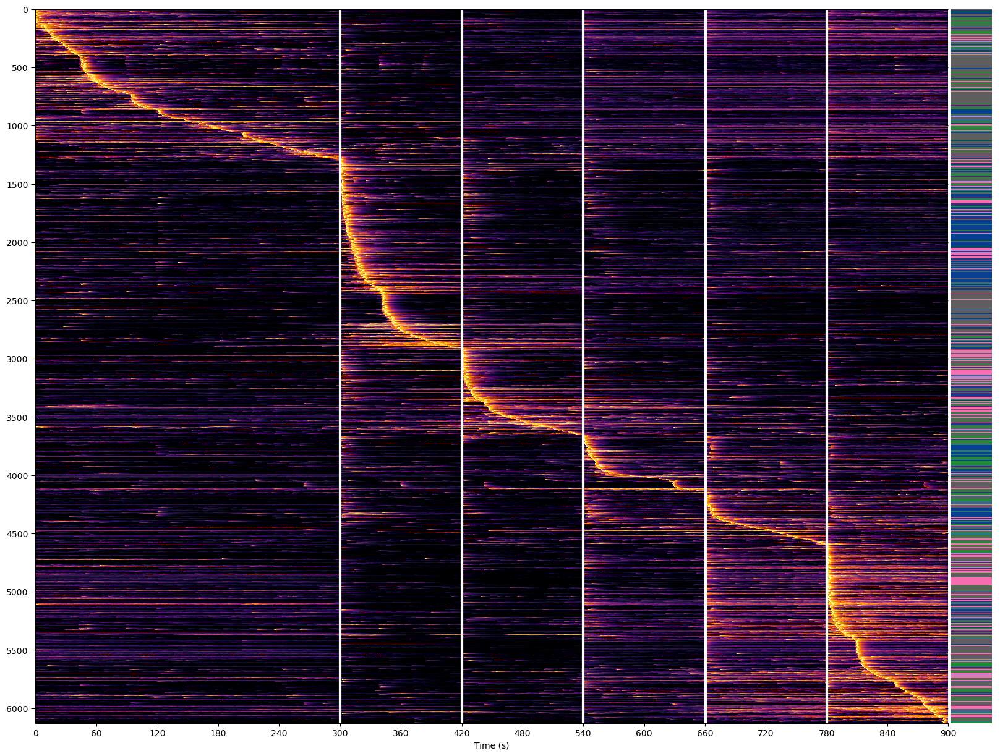

In [66]:
# Heatmaps of all neurons from all stimuli - sorted by peak response
if region == "vagal":
	y_tick_interval = 100
elif region == "hindbrain":
	y_tick_interval = 500

plot_grouped_heatmaps(sorted_df, colors=region_colors, filterby=["responsive"], sort=True, key='norm_temporal', savefig=False, save_path=tank.data_paths["figures"], fps=fps, y_tick_interval=y_tick_interval)

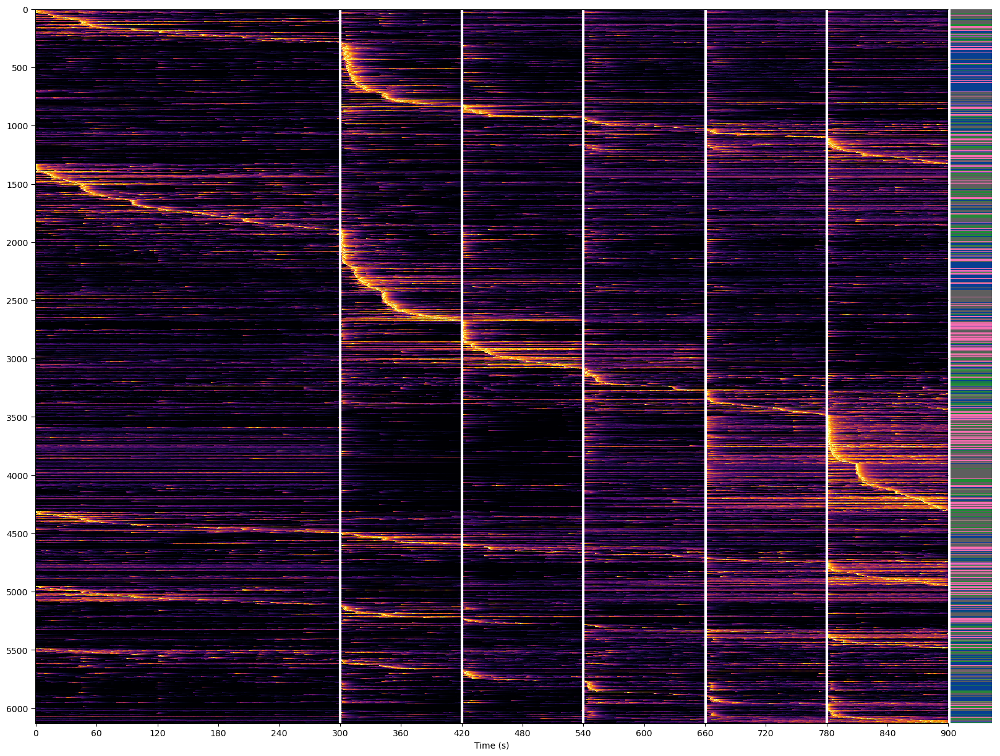

In [67]:
# Heatmaps of all neurons from all stimuli - sorted by peak response in each component
if region == "vagal":
	y_tick_interval = 100
elif region == "hindbrain":
	y_tick_interval = 500

component_sorted_data, component_sorted_colors = sort_by_neuron_component(np.vstack(sorted_df["norm_temporal"]), classified_neuron_idxs, separate_array=region_colors, sort_within_component=True)
plot_heatmap_with_colorbar(component_sorted_data, component_sorted_colors, sort=False, fps=fps, y_tick_interval=y_tick_interval)

/var/folders/48/8y2gqcvx5q5575kwkzngl6qw0000gn/T/ipykernel_57596/3480736261.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 1, figsize=(10, 1))


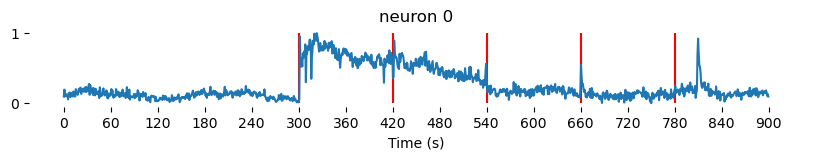

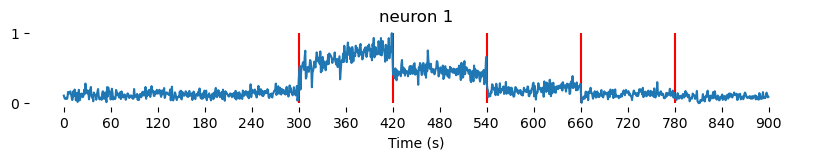

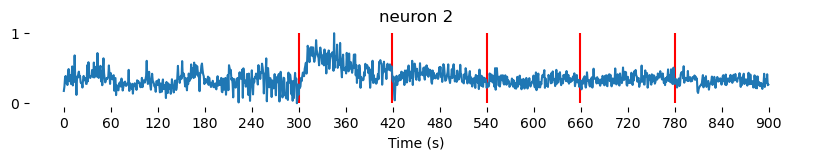

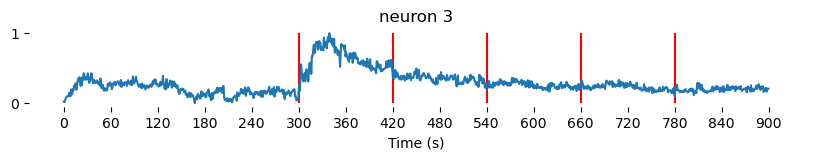

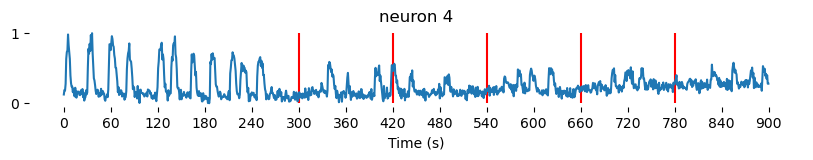

...

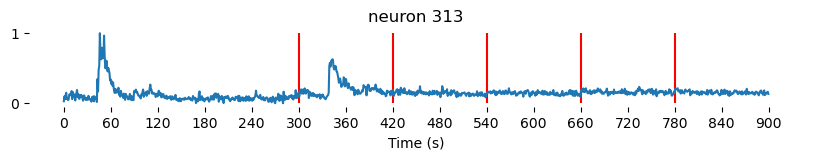

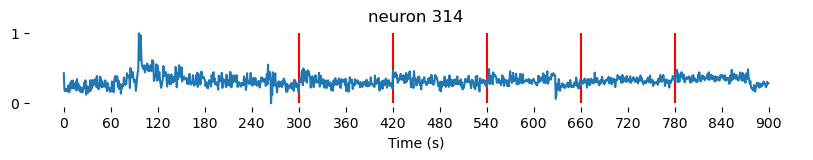

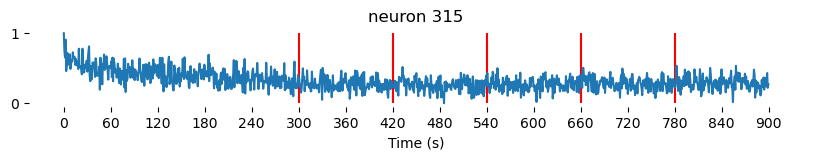

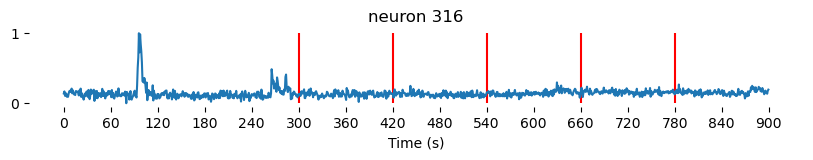

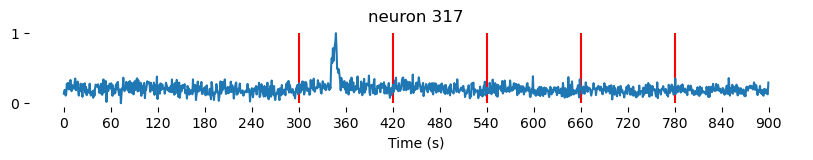

In [7]:
component = 2
subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]
subdf = subdf[subdf.stimulus == "eggwater"]

traces = list()
pulse_frames = list()

for i, row in subdf.iterrows():
	traces.append(row[key])
	pulse_frames.append(row["pulse_frames"])

for i, t in enumerate(traces):
	fig, axes = plt.subplots(1, 1, figsize=(10, 1))
	for pulse in pulse_frames[i]:
		axes.vlines(pulse, 0, 1, color='r')

	axes.plot(t, color='tab:blue')
	axes.set_title(f"neuron {i}")
		
	axes.spines['top'].set_visible(False)
	axes.spines['right'].set_visible(False)
	axes.spines['bottom'].set_visible(False)
	axes.spines['left'].set_visible(False)

	ticks = np.arange(0, 16*60*fps, 60*fps)
	axes.set_xticks(ticks=ticks, labels=np.round(ticks/fps).astype(int))

	axes.set_xlabel('Time (s)')

### Temporal dynamics of clustered neurons

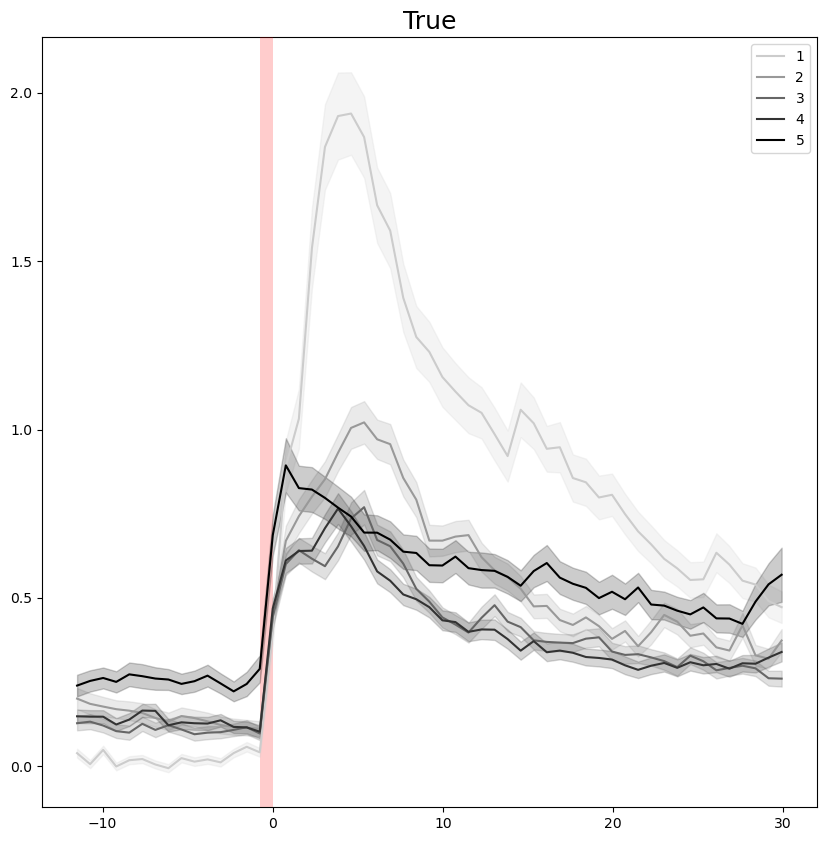

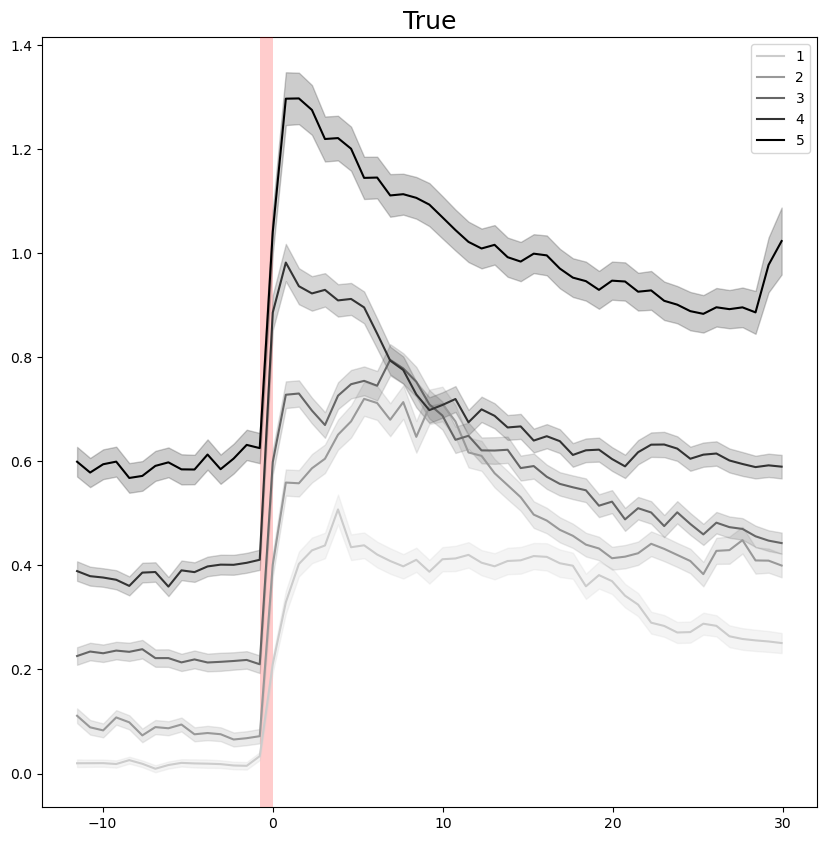

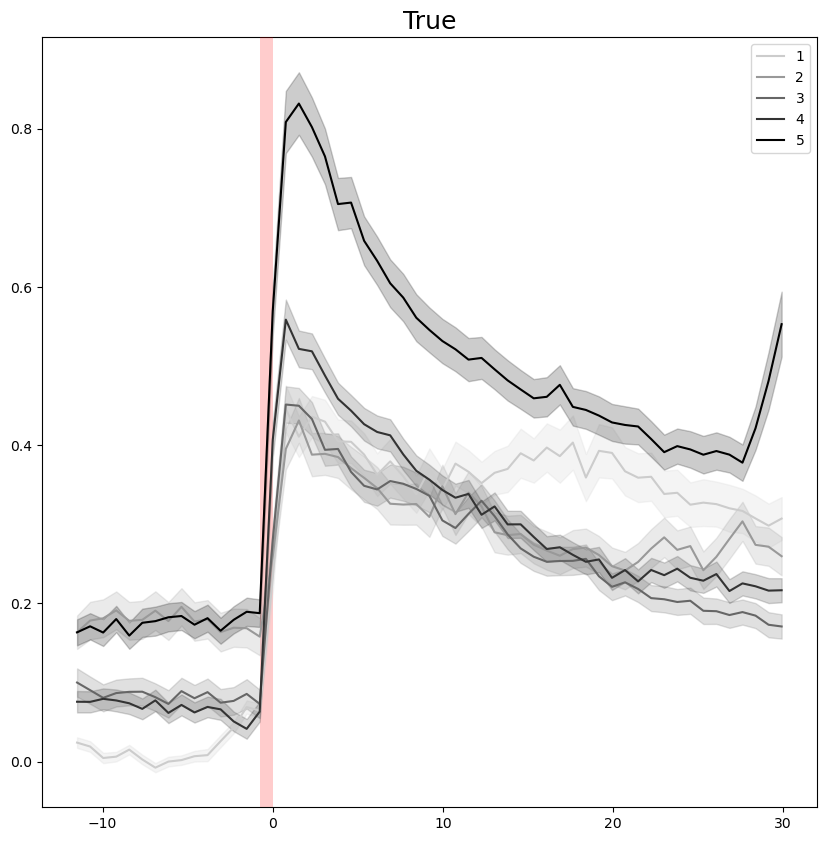

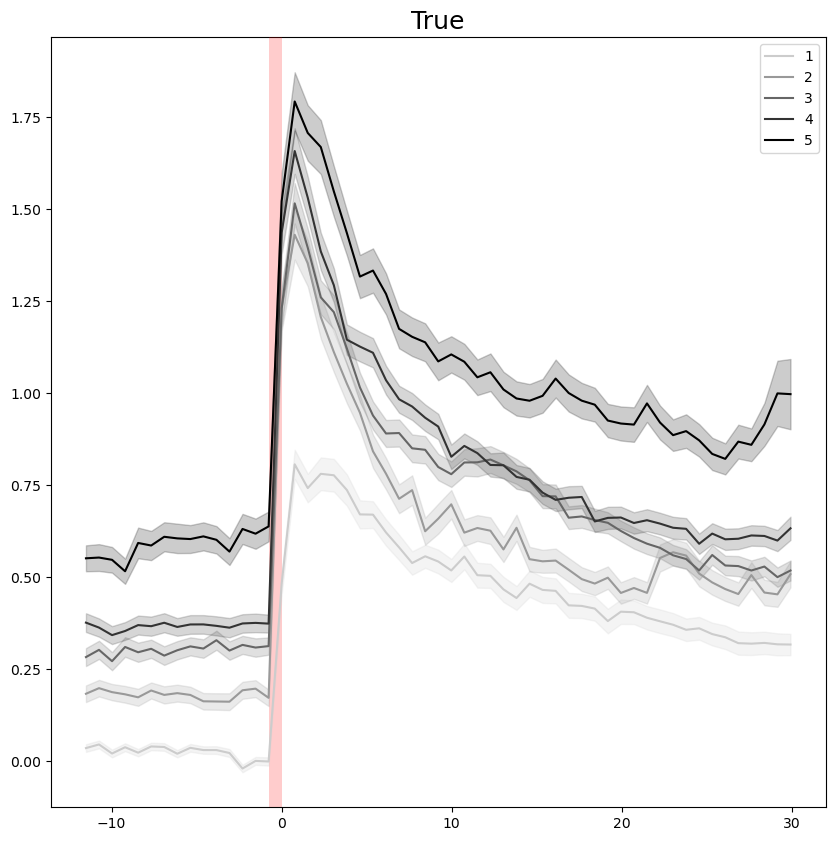

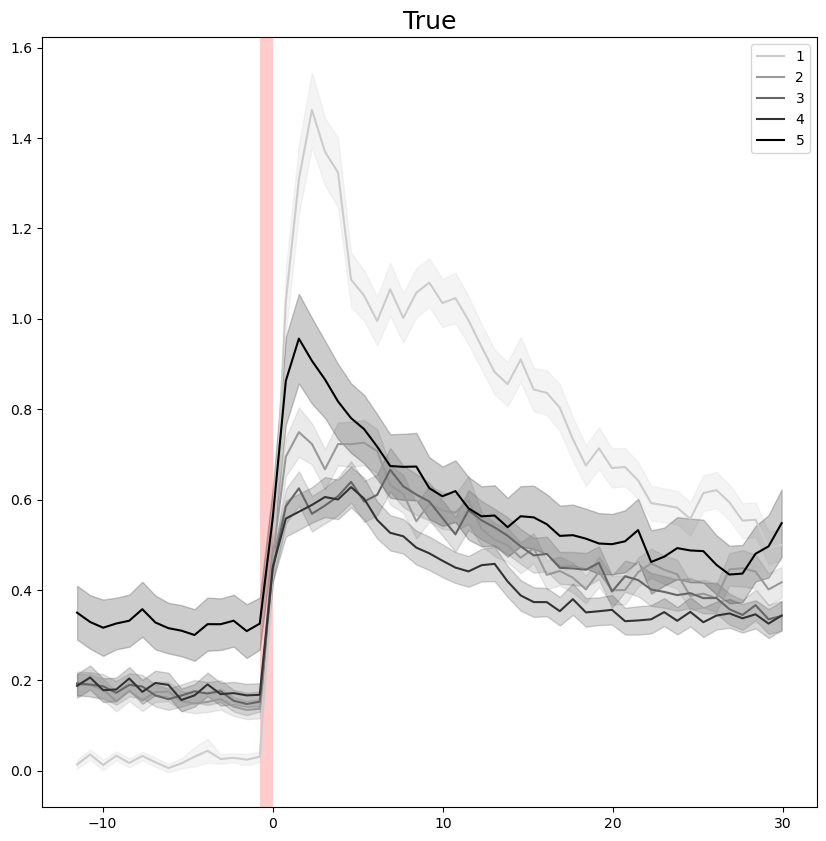

In [206]:
# Plot all the classified neurons
for component in range(sorted_components.shape[0]):
	subdf = sorted_df.loc[classified_neuron_idxs[component], :]

	plot_pulses_overlayed(subdf, ["responsive"], 
								pre_frame_num=15, 
								post_frame_num=39, normalize=False, 
								normalize_by_first=True, key='raw_norm_temporal', fps=fps,
								only_responsive=False, savefig=False, save_path=tank.data_paths["figures"])

In [55]:
# Number of positive- and negative-weighted neurons in component
for component in range(sorted_components.shape[0]):
	print(f"Component {component}: {len(classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)])} positive and {len(classified_neuron_idxs[component][np.where(classified_neurons[component] < 0)])} negative neurons\n")

Component 0: 1023 positive and 306 negative neurons

Component 1: 2276 positive and 702 negative neurons

Component 2: 382 positive and 259 negative neurons

Component 3: 345 positive and 194 negative neurons

Component 4: 413 positive and 228 negative neurons



In [58]:
for component in range(sorted_components.shape[0]):
	# subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]
	subdf = sorted_df.loc[classified_neuron_idxs[component], :]
	print(f"Component {component}: {len(subdf.fish_id.unique())} classified fish out of {len(sorted_df.fish_id.unique())} fish")
	print(f"Not expressed in fish: {[i for i in sorted_df.fish_id.unique() if i not in subdf.fish_id.unique()]}\n")

Component 0: 13 classified fish out of 13 fish
Not expressed in fish: []

Component 1: 13 classified fish out of 13 fish
Not expressed in fish: []

Component 2: 13 classified fish out of 13 fish
Not expressed in fish: []

Component 3: 13 classified fish out of 13 fish
Not expressed in fish: []

Component 4: 13 classified fish out of 13 fish
Not expressed in fish: []



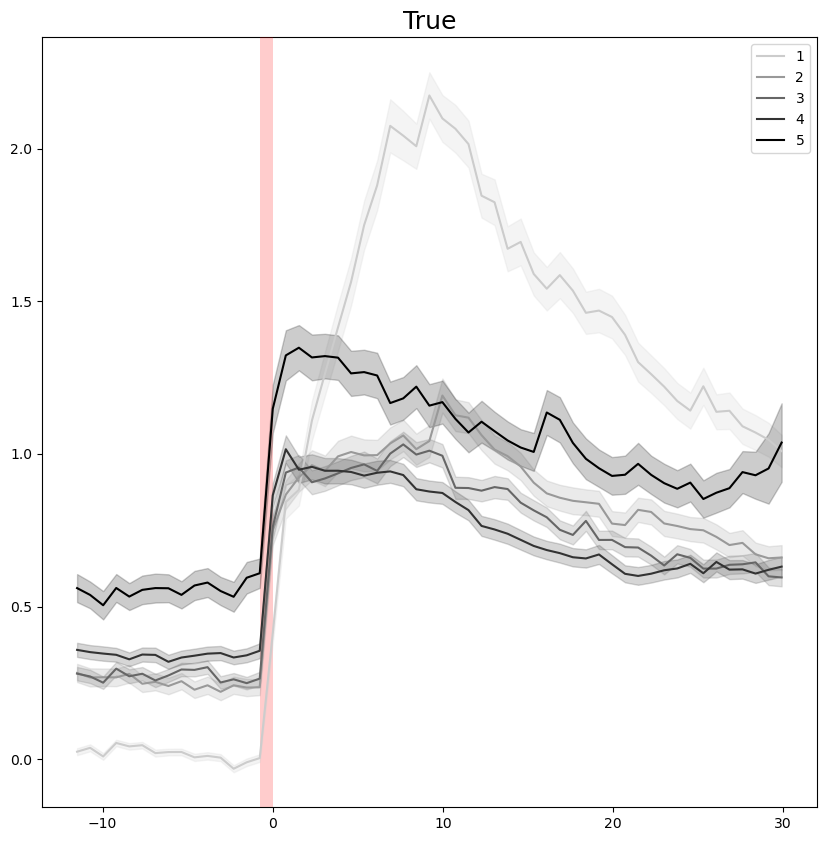

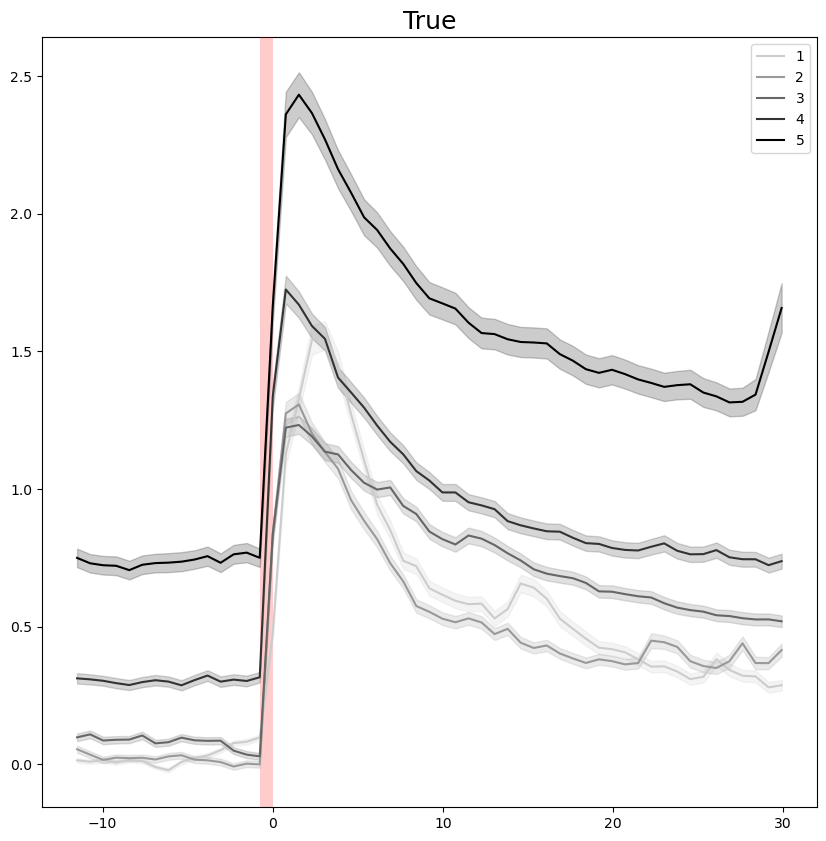

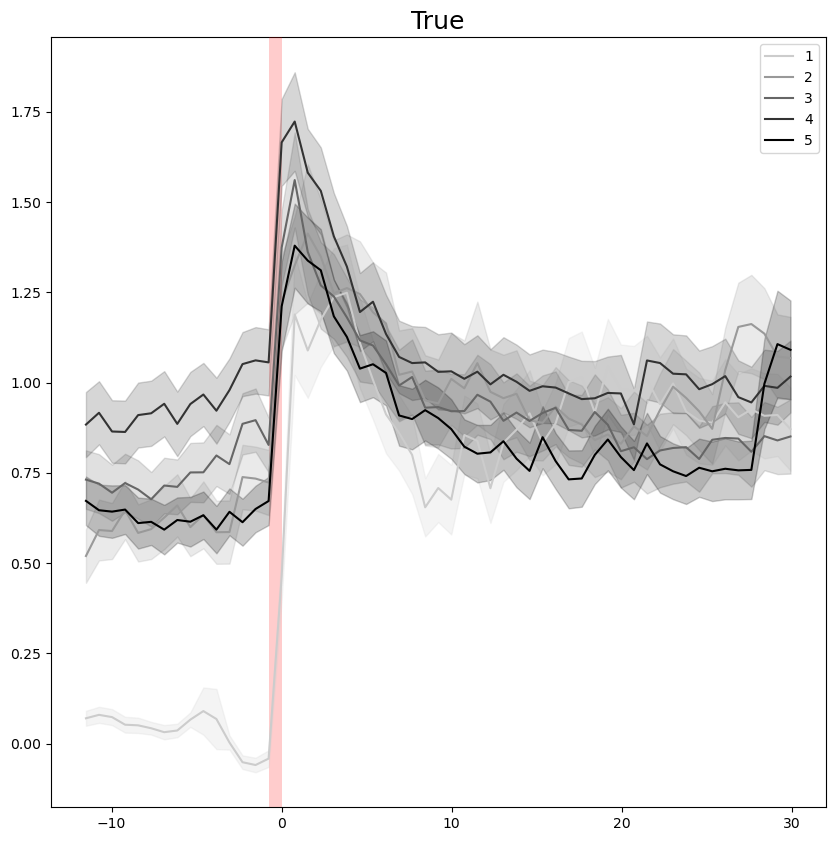

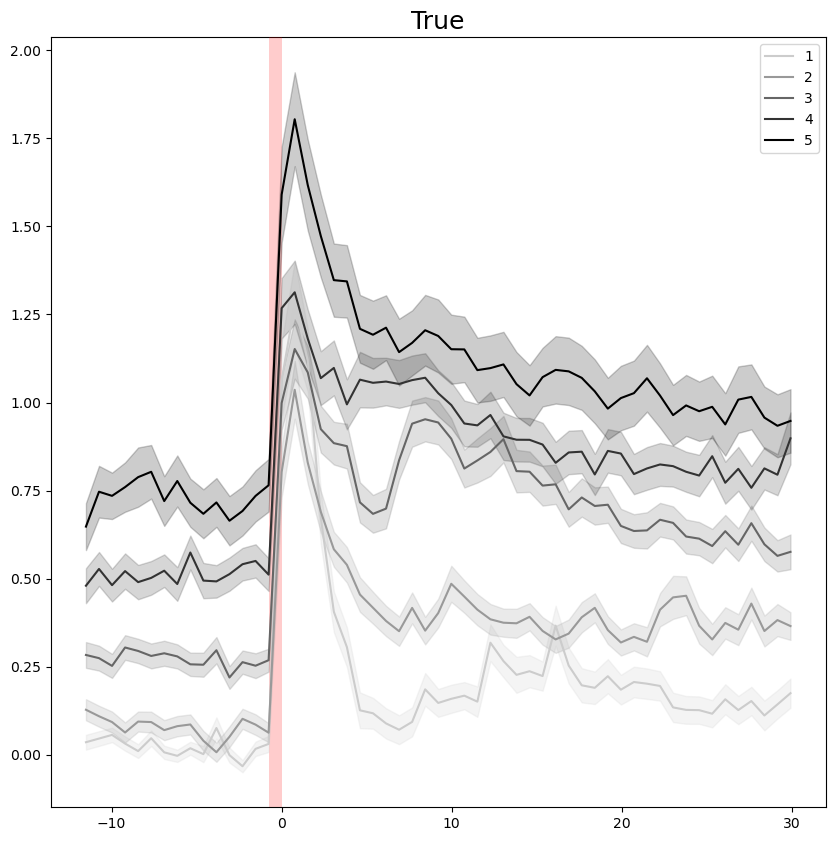

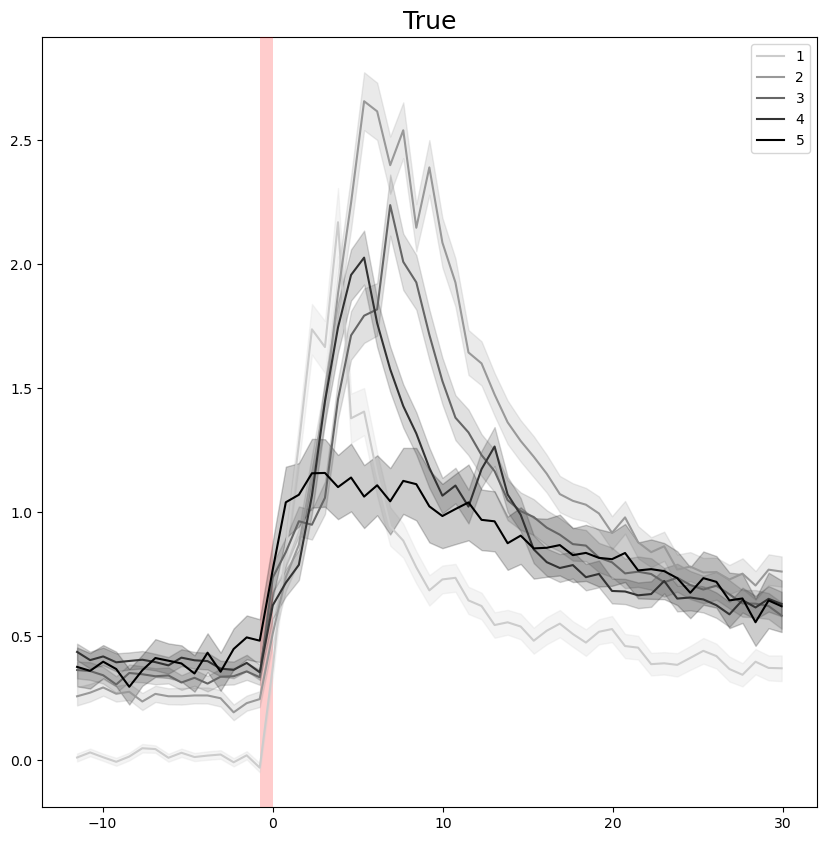

In [155]:
# Plot only the positive-weighted neurons
for component in range(sorted_components.shape[0]):
	subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

	plot_pulses_overlayed(subdf, ["responsive"], 
								pre_frame_num=15, 
								post_frame_num=39, normalize=False, 
								normalize_by_first=True, key='raw_norm_temporal', fps=fps,
								only_responsive=True, savefig=False, save_path=tank.data_paths["figures"])

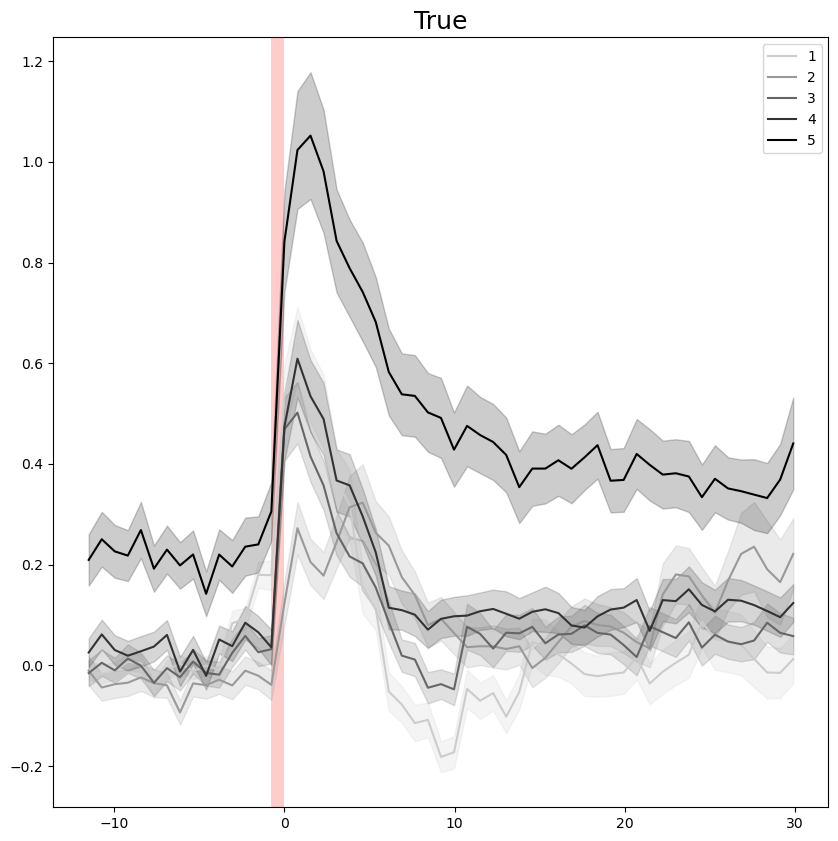

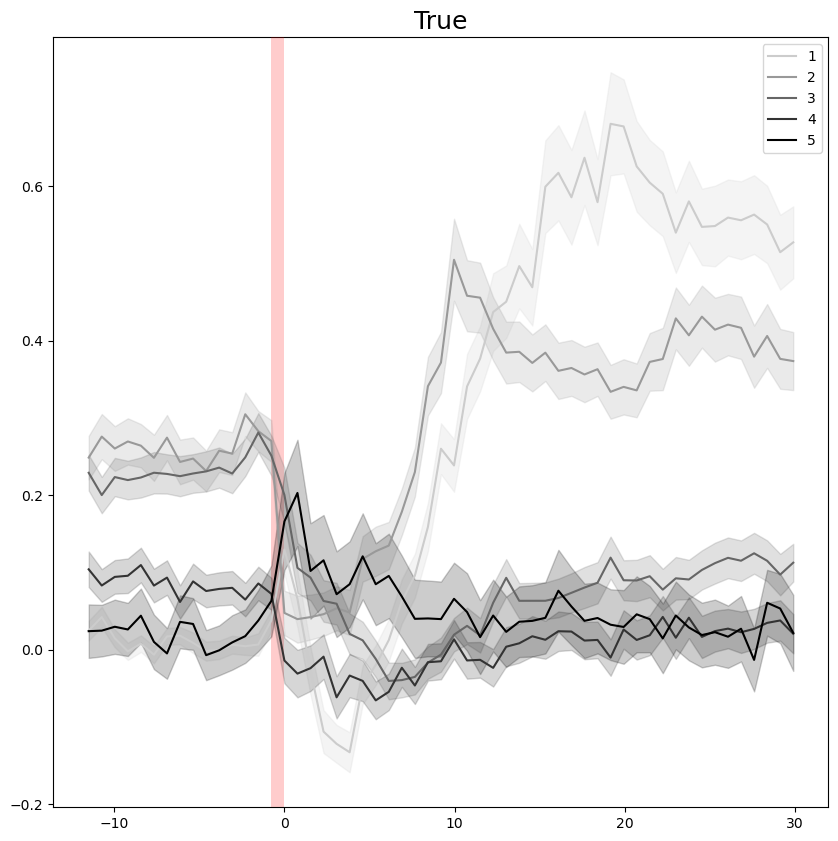

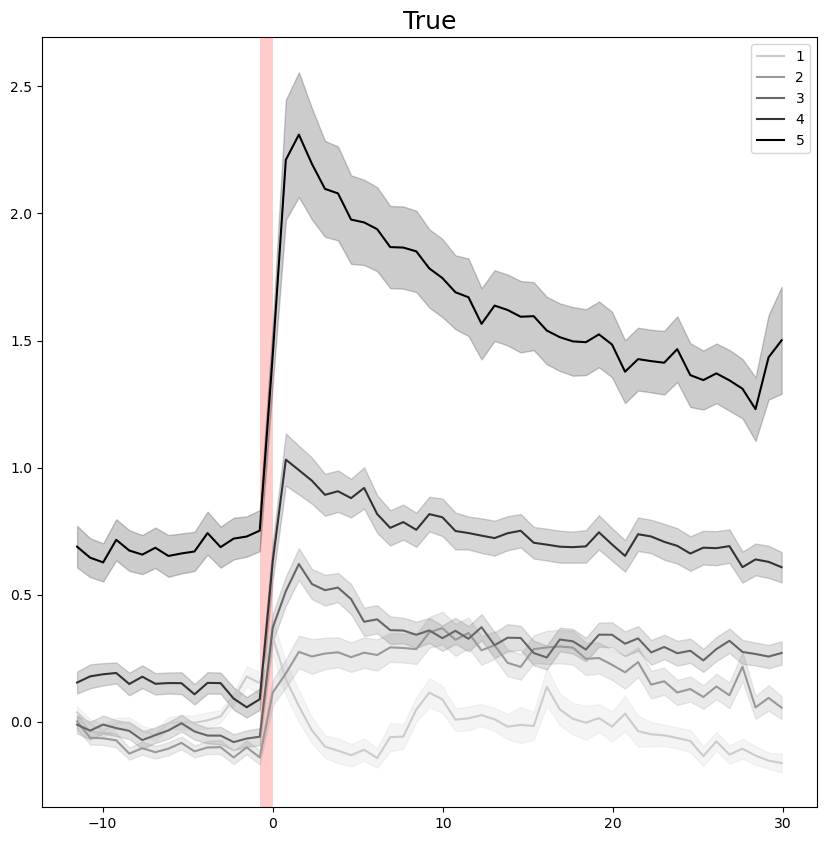

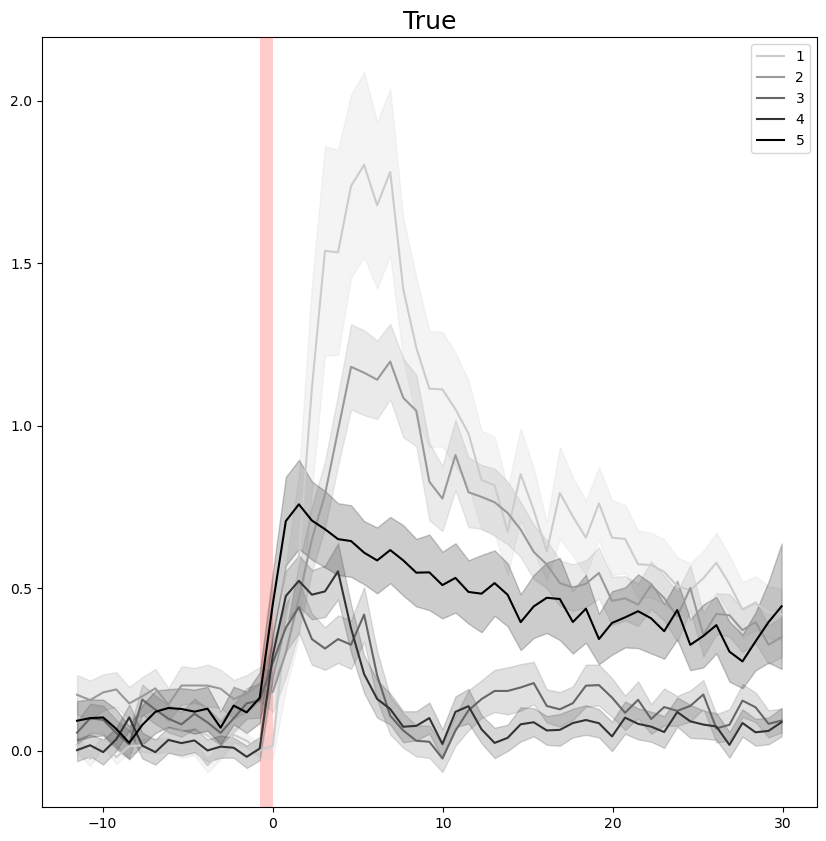

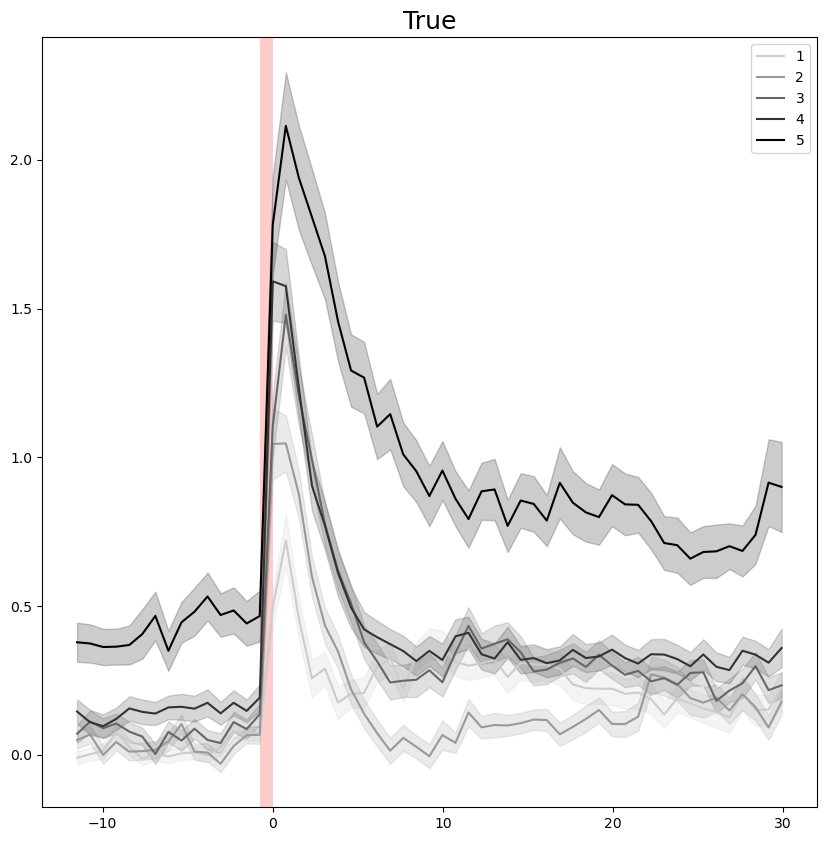

In [54]:
# Plot only the negative-weighted neurons
for component in range(sorted_components.shape[0]):
	subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] < 0)], :]

	plot_pulses_overlayed(subdf, ["responsive"], 
								pre_frame_num=15, 
								post_frame_num=39, normalize=False, 
								normalize_by_first=True, key='raw_norm_temporal', fps=fps,
								only_responsive=True, savefig=False, save_path=tank.data_paths["figures"])

In [89]:
# Pulse traces per component - POSITIVE WEIGHTS
component = 0

subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

pulse_df = get_pulse_traces(subdf, normalize_by_first=True, pre_frame_num=15, post_frame_num=39, key="raw_norm_temporal")

In [1682]:
x = np.arange(0-15, 0+39+1)
x/fps

array([-11.50378983, -10.73687051,  -9.96995118,  -9.20303186,
        -8.43611254,  -7.66919322,  -6.9022739 ,  -6.13535457,
        -5.36843525,  -4.60151593,  -3.83459661,  -3.06767729,
        -2.30075797,  -1.53383864,  -0.76691932,   0.        ,
         0.76691932,   1.53383864,   2.30075797,   3.06767729,
         3.83459661,   4.60151593,   5.36843525,   6.13535457,
         6.9022739 ,   7.66919322,   8.43611254,   9.20303186,
         9.96995118,  10.73687051,  11.50378983,  12.27070915,
        13.03762847,  13.80454779,  14.57146711,  15.33838644,
        16.10530576,  16.87222508,  17.6391444 ,  18.40606372,
        19.17298305,  19.93990237,  20.70682169,  21.47374101,
        22.24066033,  23.00757966,  23.77449898,  24.5414183 ,
        25.30833762,  26.07525694,  26.84217626,  27.60909559,
        28.37601491,  29.14293423,  29.90985355])

In [1703]:
pulse = 5  # between 1 and 5
pd.DataFrame(np.transpose(np.vstack(pd.DataFrame(pulse_df)[pulse][pd.DataFrame(pulse_df)[pulse].notnull()]))).to_clipboard()

In [95]:
# Peaks of classified neurons per component - POSITIVE WEIGHTS
component = 4

subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

labels, peaks = get_pulse_peaks_perfish(subdf,
		filterby=["responsive"], activated=1, only_responsive=True, flip_suppressed=True, peak_frame_nums=[15, 19], 
        pre_frame_num=15, post_frame_num=39, normalize=False, normalize_by_first=True, key="raw_norm_temporal")

peaks[0].to_clipboard()

In [101]:
# Changes in peak of classified neurons per component - POSITIVE WEIGHTS
component = 4

subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

labels, peaks = get_pulse_peaks_perfish(subdf,
		filterby=["responsive"], activated=1, only_responsive=True, flip_suppressed=True, peak_frame_nums=[15, 19], 
        pre_frame_num=15, post_frame_num=39, normalize=True, normalize_by_first=False, key="raw_norm_temporal")

peaks[0].to_clipboard()

In [130]:
13/fps

9.969950999999961

In [106]:
# Baseline AUCs per component - POSITIVE WEIGHTS
component = 4

subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

labels, aucs = get_pulse_aucs_perfish(subdf, 
                       filterby=["responsive"],
                       activated=1,
                       auc_frame_nums=[0, 14], pre_frame_num=15, post_frame_num=39, 
                       normalize_by_first=True, key='raw_norm_temporal', 
                       only_responsive=True)

aucs[0].to_clipboard()  # 0 for habituating, 1 for integrating

In [111]:
# Times to peak per component - POSITIVE WEIGHTS
component = 4

subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

labels, t_peaks = get_pulse_peaktimes_perfish(subdf,
                 filterby=["responsive"], activated=1, flip_suppressed=True, only_responsive=True, fps=fps, 
                 peak_frame_nums=[15, 28], pre_frame_num=15, 
                 post_frame_num=39, normalize=True, key='raw_norm_temporal')

t_peaks[0].to_clipboard()

In [116]:
# Times at half maximum per component - POSITIVE WEIGHTS
component = 4

subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

labels, thms = get_pulse_thms_perfish(subdf,
                 filterby=["responsive"], activated=1, flip_suppressed=True, only_responsive=True, fps=fps, 
                 peak_frame_nums=[15, 28], pre_frame_num=15, 
                 post_frame_num=39, normalize=True, key='raw_norm_temporal')

thms[0].to_clipboard()

In [127]:
# Times to decay per component - POSITIVE WEIGHTS
component = 4

subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]

labels, decays = get_pulse_decays_perfish(subdf,
                 filterby=["responsive"], activated=1, flip_suppressed=True, only_responsive=True, fps=fps, non_sig_cutoff=2, pre_frame_num=15, 
                 peak_frame_nums=[15, 19], 
                 post_frame_num=155, normalize=True, key='raw_norm_temporal')

decays[0].to_clipboard()

In [68]:
cmap = get_cmap('Set1')  # type: matplotlib.colors.ListedColormap
colors = cmap.colors  # type: list
colors[0]

/var/folders/48/8y2gqcvx5q5575kwkzngl6qw0000gn/T/ipykernel_74165/1627055155.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('Set1')  # type: matplotlib.colors.ListedColormap


(0.8941176470588236, 0.10196078431372549, 0.10980392156862745)

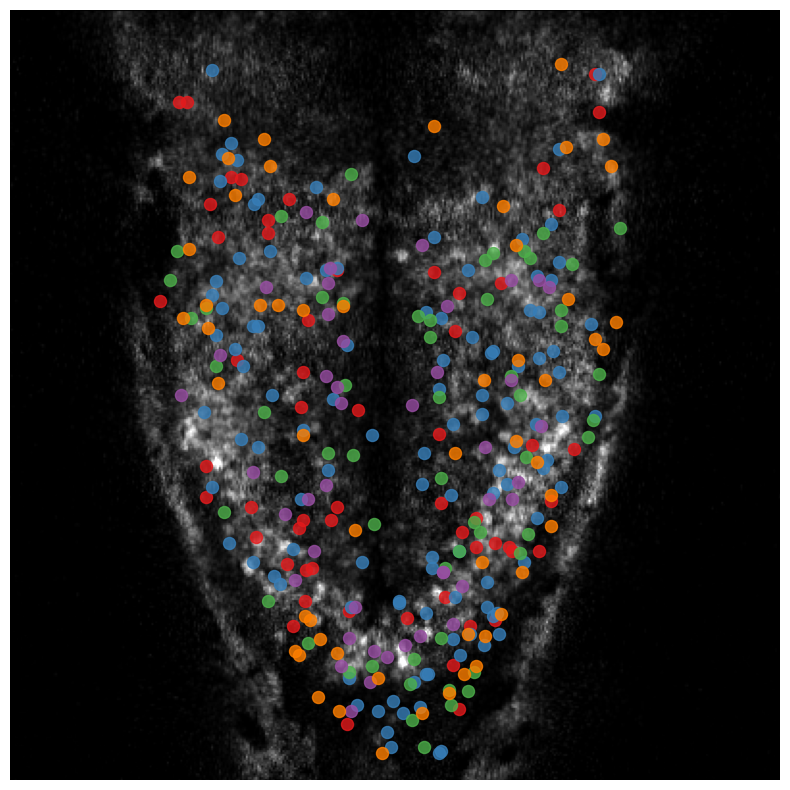

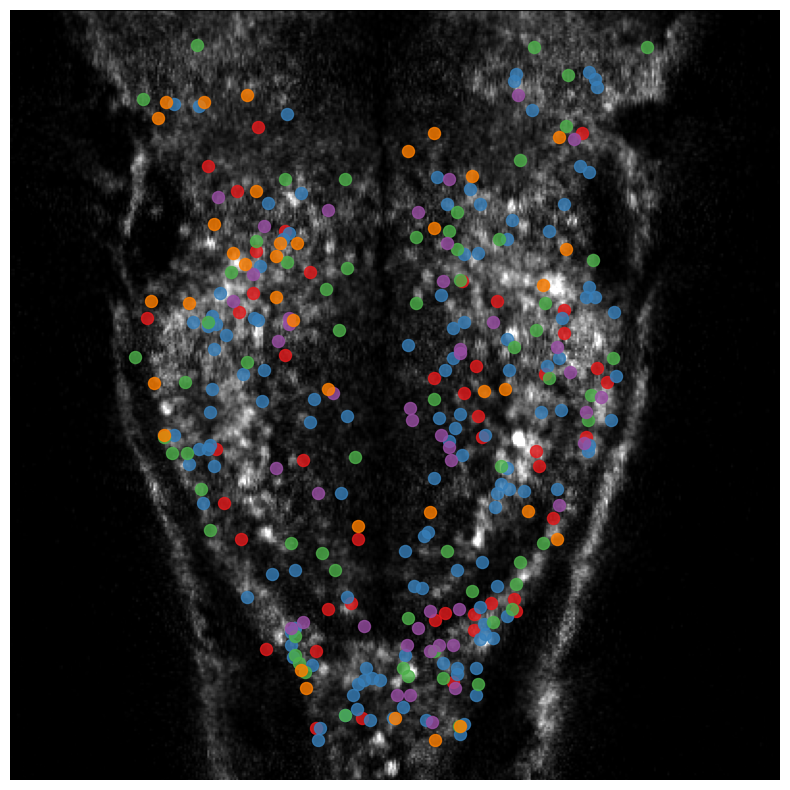

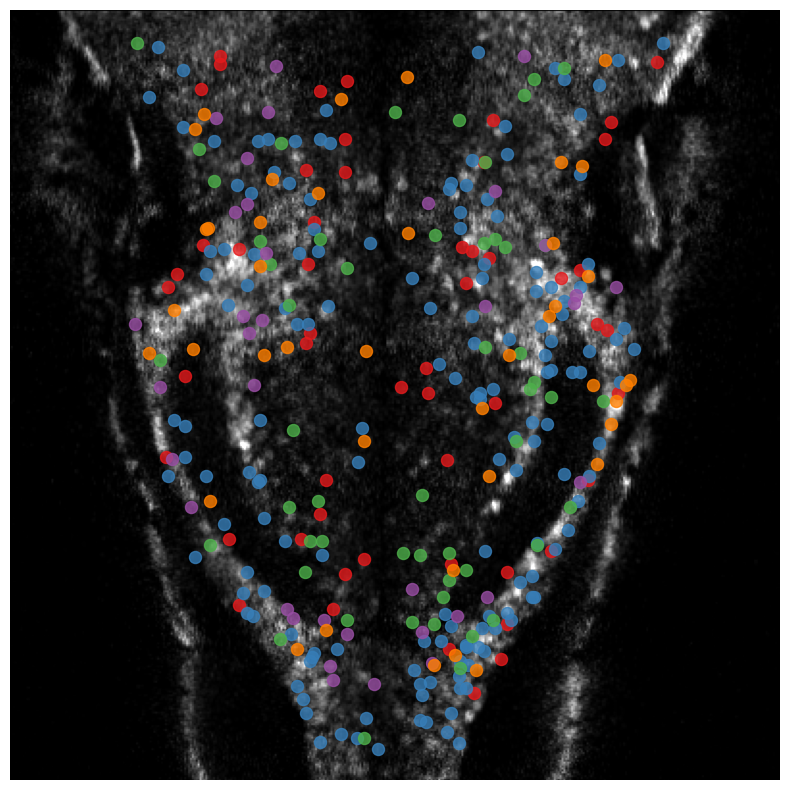

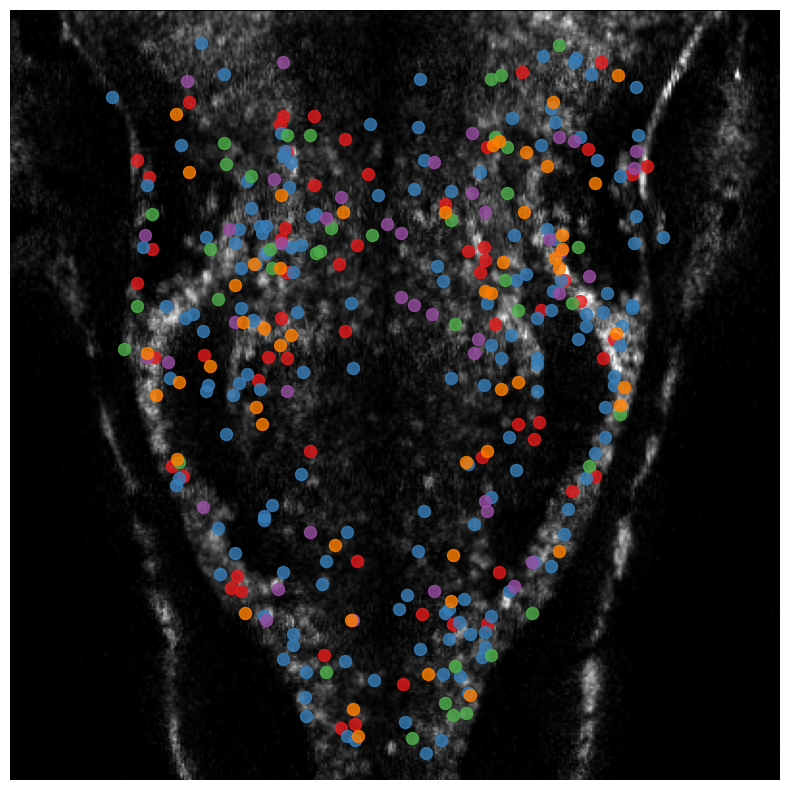

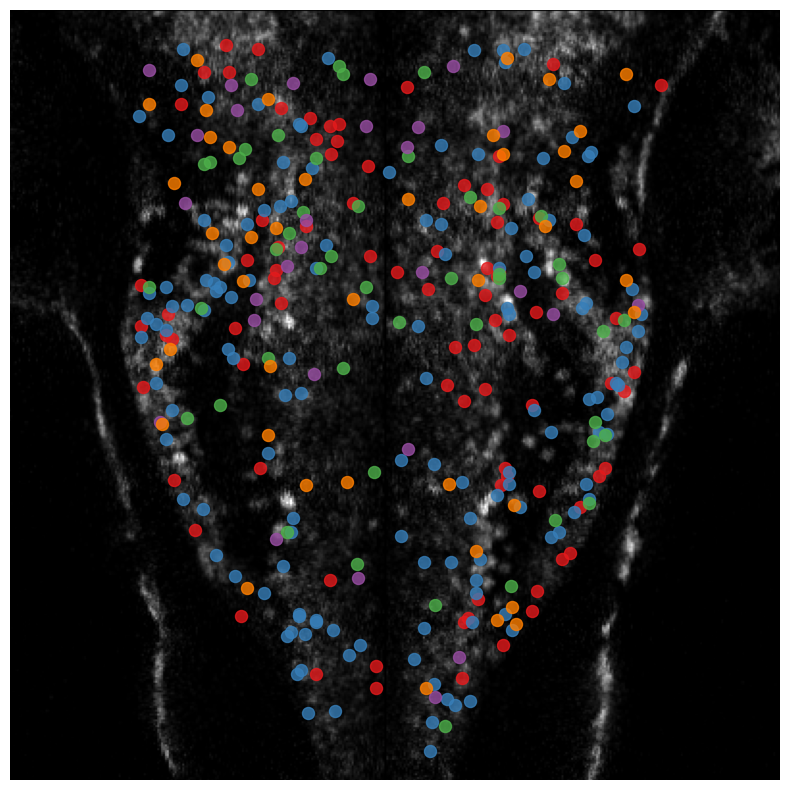

In [73]:
# Spatial localization of neuron components

# Set both values to False if you want to plot all classified neurons
only_pos = False
only_neg = True

img = imread(r"/Volumes/Rapid/bruker2P_data/hindbrain/reference_brain/hindbrain_cropped_smallsize_anatomystack.ome.tif")
plane_idxs = [4, 6, 8, 10, 12]

for plane in range(5):  # for each plane
	fig, ax = plt.subplots(figsize=(10, 10))

	# img = imread(Path(data_folder).joinpath(fr'elavl3H2BGCaMP8m_7dpf_fed_AITC_25mM_50_20240528/img_stack_{plane}/image.tif'))
	# avg_img = np.mean(img[725:831, :, :], axis=0)

	avg_img = img[plane_idxs[plane]]
	avg_img = embed_image(avg_img, 1024)

	plt.imshow(avg_img, cmap="gray", vmax=500)

	for component in range(sorted_components.shape[0]):
		if only_pos and not only_neg:
			subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] > 0)], :]
		elif only_neg and not only_pos:
			subdf = sorted_df.loc[classified_neuron_idxs[component][np.where(classified_neurons[component] < 0)], :]
		else:
			subdf = sorted_df.loc[classified_neuron_idxs[component], :]

		subdf = subdf[subdf["plane"] == plane]
		for com in subdf["com_aligned"]:
			plt.scatter(com[0][0], com[0][1], color=colors[component], s=75, alpha=0.8)

	plt.xlim(290, 290+400)
	plt.ylim(310+400, 310)
	plt.axis('off')

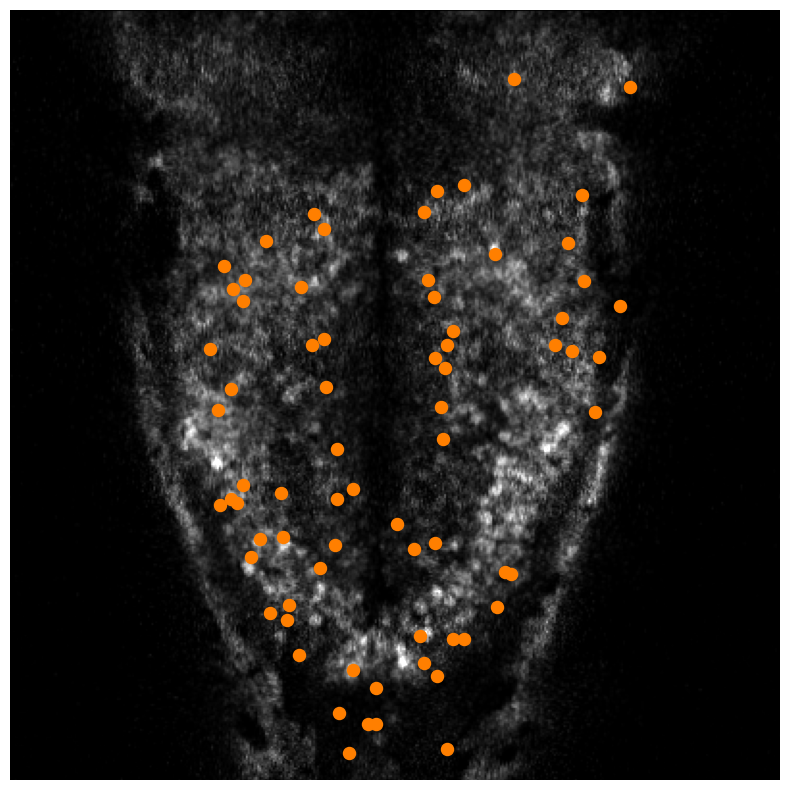

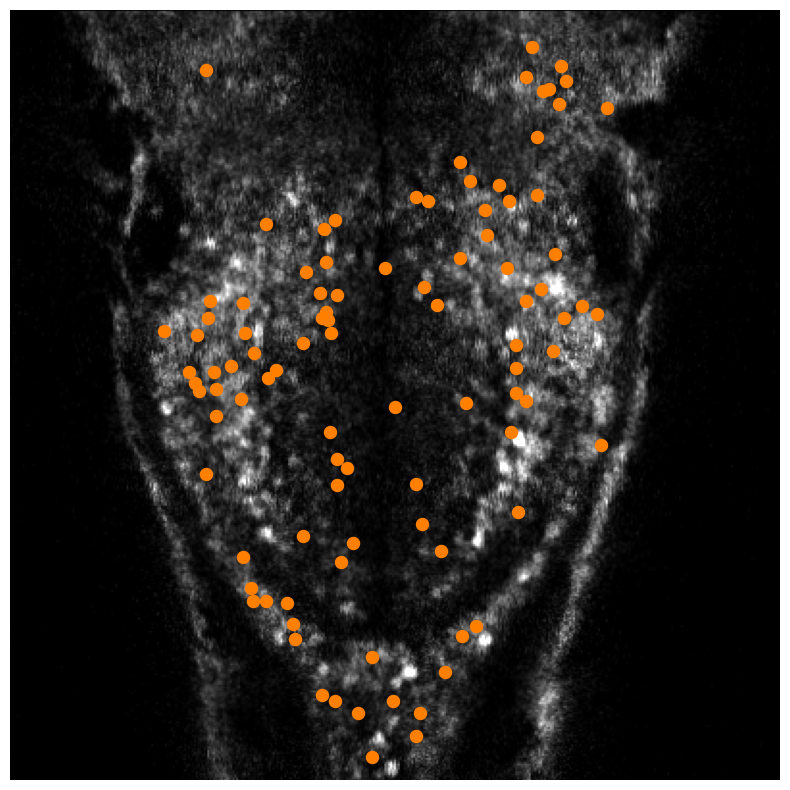

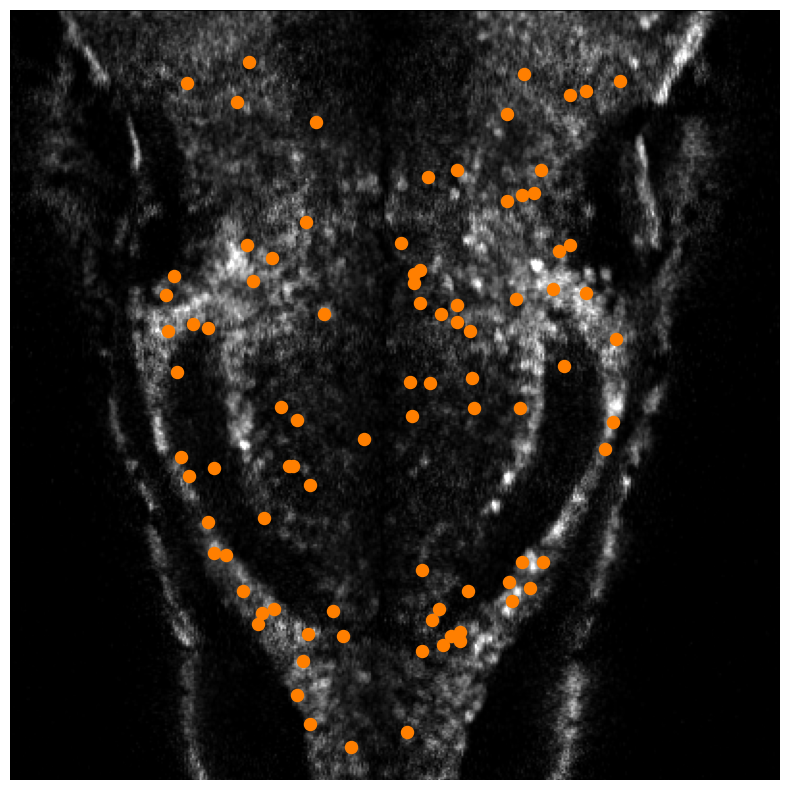

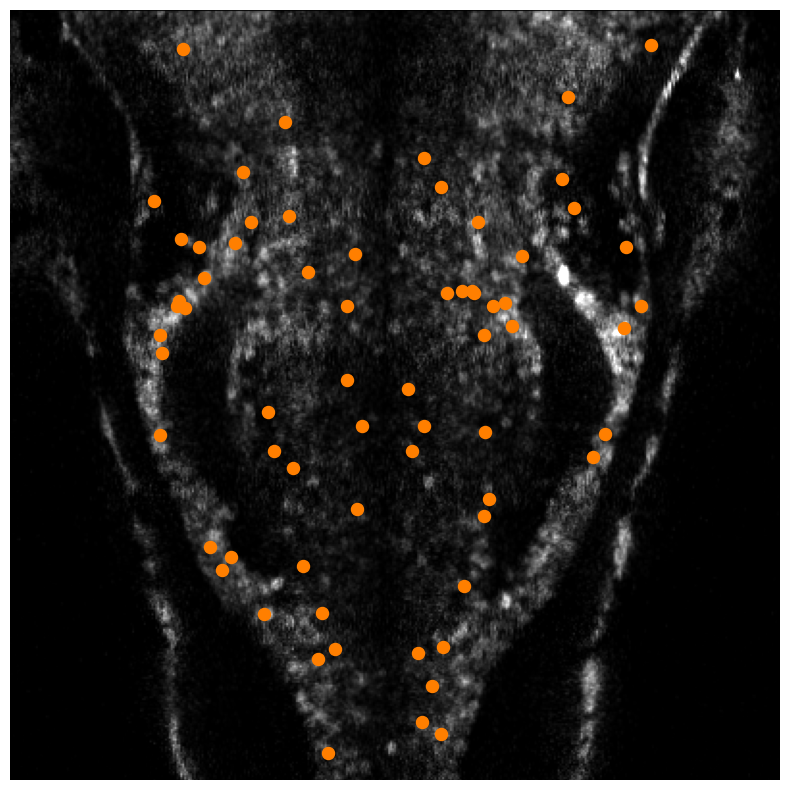

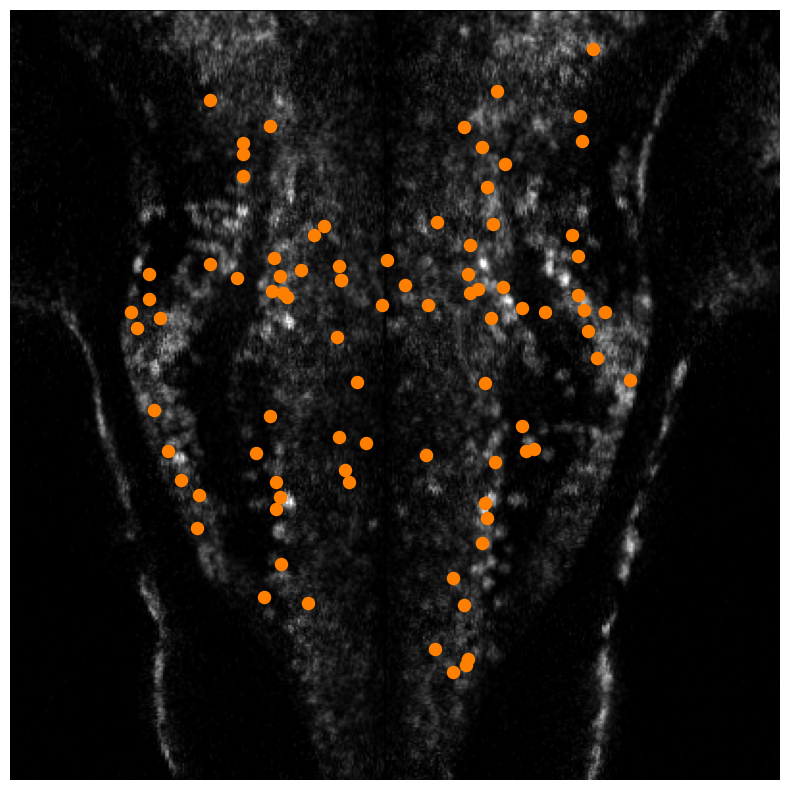

In [88]:
# Spatial localization of neuron components - PER COMPONENT
comp_to_plot = 4

# Set both values to False if you want to plot all classified neurons
only_pos = False
only_neg = True

img = imread(r"/Volumes/Rapid/bruker2P_data/hindbrain/reference_brain/hindbrain_cropped_smallsize_anatomystack.ome.tif")
plane_idxs = [4, 6, 8, 10, 12]

for plane in range(5):  # for each plane
	fig, ax = plt.subplots(figsize=(10, 10))

	# img = imread(Path(data_folder).joinpath(fr'elavl3H2BGCaMP8m_7dpf_fed_AITC_25mM_50_20240528/img_stack_{plane}/image.tif'))
	# avg_img = np.mean(img[725:831, :, :], axis=0)

	avg_img = img[plane_idxs[plane]]
	avg_img = embed_image(avg_img, 1024)

	plt.imshow(avg_img, cmap="gray", vmax=500)

	if only_pos and not only_neg:
		subdf = sorted_df.loc[classified_neuron_idxs[comp_to_plot][np.where(classified_neurons[comp_to_plot] > 0)], :]
	elif only_neg and not only_pos:
		subdf = sorted_df.loc[classified_neuron_idxs[comp_to_plot][np.where(classified_neurons[comp_to_plot] > 0)], :]
	else:
		subdf = sorted_df.loc[classified_neuron_idxs[comp_to_plot], :]

	subdf = subdf[subdf["plane"] == plane]
	for com in subdf["com_aligned"]:
		plt.scatter(com[0][0], com[0][1], color=colors[comp_to_plot], s=75)

	plt.xlim(290, 290+400)
	plt.ylim(310+400, 310)
	plt.axis('off')

In [31]:
# % of neurons in each region per component
region = "area_postrema"

df = pd.concat(dfs, ignore_index=True)

for fish in sorted_df.fish_id.unique():
	subdf = sorted_df[sorted_df["fish_id"] == fish]
	total_count = 0
	comp_0_count = 0
	comp_1_count = 0
	comp_2_count = 0
	comp_3_count = 0
	comp_4_count = 0

	for i, row in subdf.iterrows():
		if row["region_aligned_mapzebrain"] is not None and region in row["region_aligned_mapzebrain"]:
			total_count += 1
			if i in classified_neuron_idxs[0]:
				comp_0_count += 1
			elif i in classified_neuron_idxs[1]:
				comp_1_count += 1
			elif i in classified_neuron_idxs[2]:
				comp_2_count += 1
			elif i in classified_neuron_idxs[3]:
				comp_3_count += 1
			elif i in classified_neuron_idxs[4]:
				comp_4_count += 1

	for i, row in df[(df.fish_id == fish) & (df.responsive == False)].iterrows():
		if row["region_aligned_mapzebrain"] is not None and region in row["region_aligned_mapzebrain"]:
			total_count += 1

	print(f"Fish {fish}:")
	print(f"{comp_0_count/total_count*100}")
	print(f"{comp_1_count/total_count*100}")
	print(f"{comp_2_count/total_count*100}")
	print(f"{comp_3_count/total_count*100}")
	print(f"{comp_4_count/total_count*100}\n")	

Fish 74:
0.0
0.0
50.0
0.0
25.0

Fish 75:
0.0
0.0
66.66666666666666
0.0
0.0

Fish 73:
0.0
16.666666666666664
33.33333333333333
16.666666666666664
0.0

Fish 8:
0.0
25.0
0.0
0.0
0.0

Fish 55:
16.666666666666664
16.666666666666664
16.666666666666664
0.0
0.0

Fish 67:
0.0
50.0
50.0
0.0
0.0

Fish 68:
0.0
0.0
0.0
25.0
0.0

Fish 76:
0.0
40.0
0.0
0.0
0.0

Fish 70:
0.0
0.0
0.0
0.0
0.0

Fish 71:
20.0
0.0
20.0
0.0
20.0

Fish 49:
14.285714285714285
28.57142857142857
0.0
14.285714285714285
42.857142857142854

Fish 51:
0.0
25.0
0.0
25.0
0.0

Fish 52:
0.0
0.0
50.0
0.0
0.0



In [43]:
# % of neurons in each region per component - only positive-weighted neurons
region = "area_postrema"

df = pd.concat(dfs, ignore_index=True)

data = {
		"Fish": [],
		"Comp 0": [],
		"Comp 1": [],
		"Comp 2": [],
		"Comp 3": [],
		"Comp 4": []
	}

for fish in sorted_df.fish_id.unique():
	subdf = sorted_df[sorted_df["fish_id"] == fish]
	total_count = 0
	comp_0_count = 0
	comp_1_count = 0
	comp_2_count = 0
	comp_3_count = 0
	comp_4_count = 0

	for i, row in subdf.iterrows():
		if row["region_aligned_mapzebrain"] is not None and region in row["region_aligned_mapzebrain"]:
			total_count += 1
			if i in classified_neuron_idxs[0][np.where(classified_neurons[0] > 0)]:
				comp_0_count += 1
			elif i in classified_neuron_idxs[1][np.where(classified_neurons[1] > 0)]:
				comp_1_count += 1
			elif i in classified_neuron_idxs[2][np.where(classified_neurons[2] > 0)]:
				comp_2_count += 1
			elif i in classified_neuron_idxs[3][np.where(classified_neurons[3] > 0)]:
				comp_3_count += 1
			elif i in classified_neuron_idxs[4][np.where(classified_neurons[4] > 0)]:
				comp_4_count += 1

	for i, row in df[(df.fish_id == fish) & (df.responsive == False)].iterrows():
		if row["region_aligned_mapzebrain"] is not None and region in row["region_aligned_mapzebrain"]:
			total_count += 1

	data["Fish"].append(fish)
	data["Comp 1"].append(comp_0_count / total_count * 100)
	data["Comp 2"].append(comp_1_count / total_count * 100)
	data["Comp 3"].append(comp_2_count / total_count * 100)
	data["Comp 4"].append(comp_3_count / total_count * 100)
	data["Comp 5"].append(comp_4_count / total_count * 100)

df_result = pd.DataFrame(data)
df_result.transpose().to_clipboard()